# Feb 27:  Modify existing RTSTRUCT file to overlay over different scans


## Similar to v2 but make it more general so that all that is needed is:
## 1. The project, subject, session and ROI label to be copied
## 2. Which project, subject and session to copy the RTSTRUCT to, as well as any custom label.

### The algorithm will:
### 1. Download the DICOM-RTSTRUCT file to be copied to a temporary location
### 2. Download the DICOMs of the project/subject/session that contours are to be copied to (to a temp location)
### 3. Copy the DICOM-RTSTRUCT file, modify it accordingly, and save it.

### Then after uploading the DICOM-RTSTRUCT file using ROIUploadAssistance tool, verify that the contours are overlaid as expected in the OHIF-Viewer.

In [122]:
import xnat
#xnat.__version__ # 0.3.21
print(f'XNATpy version = {xnat.__version__}') # 0.3.21
import SimpleITK as sitk
import pydicom
import dicom2nifti
import numpy as np
#import math
import matplotlib.pyplot as plt
#from matplotlib import pyplot
import matplotlib.image as mpimg
import os, sys, time
import natsort
import dicom_functions
import explore_dicom_data
from myshow import myshow
import importlib
import cv2
print(f'OpenCV version = {cv2.__version__}') # 4.1.2
import copy
import DicomHelperFuncs
from DicomHelperFuncs import GetDicomFpaths
from ModifyROIs import ModifyROIs
from PlotDICOMsAndROIs import PlotDICOMsAndROIs
import importlib

#import ModifyROIs
#importlib.reload(ModifyROIs)
#from ModifyROIs import ModifyROIs

XNATpy version = 0.3.21
OpenCV version = 4.1.2


# Connect to XNAT server:

In [2]:
xnatAddress = 'http://10.1.1.17'

session = xnat.connect(xnatAddress, user='admin', password='admin')
#session = xnat.connect(xnatAddress, user='admin', password='admin', debug=True)
session

# Download the data from XNAT

### Define the REST path variables:

In [157]:
# Define the REST variables that point to the DICOM-RTSTRUCT file to be copied:

RoiProjLab = 'BrainTumorProg'
RoiSubjLab = 'PGBM-002'
##fromExpNo = 0 # (= 1 in XNAT web app; e.g. ‘PGM-002_MR_1’)
RoiExpLab = 'PGBM-002_MR_1'
RoiLab = 'RTSTRUCT_20200123_145731'
##fromScanNo = 0 # 0 -> T1post
##fromScanLabel = 'T1post'

# Define the REST variables that point to the DICOM files that the ROI applies to:

fromDicomProjLab = 'BrainTumorProg'
fromDicomSubjLab = 'PGBM-002'
##toExpNo = 0 # (= 1 in XNAT web app; e.g. ‘PGM-002_MR_1’)
fromDicomExpLab = 'PGBM-002_MR_1'
##toScanNo = 0 # 0 -> T1post
fromDicomScanLab = 'T1post'

# Define the REST variables that point to the DICOM files that the ROI is to be applied to:

toDicomProjLab = 'BrainTumorProg'
#toDicomSubjLab = 'PGM-002'
toDicomSubjLab = 'PGBM-002'
##toExpNo = 0 # (= 1 in XNAT web app; e.g. ‘PGM-002_MR_1’)
#toDicomExpLab = 'PGM-002_MR_1'
toDicomExpLab = 'PGBM-002_MR_2'
##toScanNo = 0 # 0 -> T1post
toDicomScanLab = 'T1post'

In [5]:
# Verify that the above variables are correct:


print('DICOM-RTSTRUCT:\n\n')

print('session.projects[RoiProjLab].subjects[RoiSubjLab].experiments[RoiExpLab].assessors:\n')
print(session.projects[RoiProjLab].subjects[RoiSubjLab].experiments[RoiExpLab].assessors)
print('\n\n')
#print(session.projects[toProjLab].subjects[toSubjLab].experiments[toExpLab].assessors)
#print('\n\n')
print('session.projects[RoiProjLab].subjects[RoiSubjLab].experiments[RoiExpLab].assessors[RoiLab]:\n')
print(session.projects[RoiProjLab].subjects[RoiSubjLab].experiments[RoiExpLab].assessors[RoiLab])
print('\n\n')
print('session.projects[RoiProjLab].subjects[RoiSubjLab].experiments[RoiExpLab].assessors[RoiLab].resources:\n')
print(session.projects[RoiProjLab].subjects[RoiSubjLab].experiments[RoiExpLab].assessors[RoiLab].resources)
print('\n\n')
#print('fromProjLab/fromSubjLab/fromExpLab/fromRoiLab/resources[0]:\n')
#print(session.projects[RoiProjLab].subjects[fromSubjLab].experiments[fromExpLab].assessors[fromRoiLab].resources[0])
#print('\n\n')
#print('fromProjLab/fromSubjLab/fromExpLab/fromRoiLab/resources[1]: (these need to be downloaded)\n')
#print(session.projects[fromProjLab].subjects[fromSubjLab].experiments[fromExpLab].assessors[fromRoiLab].resources[1])
#print('\n\n')
print('session.projects[RoiProjLab].subjects[RoiSubjLab].experiments[RoiExpLab].assessors[RoiLab].resources[''RTSTRUCT'']:\n')
print(session.projects[RoiProjLab].subjects[RoiSubjLab].experiments[RoiExpLab].assessors[RoiLab].resources['RTSTRUCT'])
print('\n\n')
print('session.projects[RoiProjLab].subjects[RoiSubjLab].experiments[RoiExpLab].assessors[RoiLab].resources[''RTSTRUCT''].label:\n')
print(session.projects[RoiProjLab].subjects[RoiSubjLab].experiments[RoiExpLab].assessors[RoiLab].resources['RTSTRUCT'].label)
print('\n\n')
print('session.projects[RoiProjLab].subjects[RoiSubjLab].experiments[RoiExpLab].assessors[RoiLab].resources[''RTSTRUCT''].id:\n')
print(session.projects[RoiProjLab].subjects[RoiSubjLab].experiments[RoiExpLab].assessors[RoiLab].resources['RTSTRUCT'].id)
print('\n\n')
print('session.projects[RoiProjLab].subjects[RoiSubjLab].experiments[RoiExpLab].assessors[RoiLab].resources[''RTSTRUCT''].description:\n')
print(session.projects[RoiProjLab].subjects[RoiSubjLab].experiments[RoiExpLab].assessors[RoiLab].resources['RTSTRUCT'].description)
print('\n\n')
print('session.projects[RoiProjLab].subjects[RoiSubjLab].experiments[RoiExpLab].assessors[RoiLab].resources[''RTSTRUCT''].files:\n')
print(session.projects[RoiProjLab].subjects[RoiSubjLab].experiments[RoiExpLab].assessors[RoiLab].resources['RTSTRUCT'].files)
print('\n\n')
print('session.projects[RoiProjLab].subjects[RoiSubjLab].experiments[RoiExpLab].assessors[RoiLab].resources[''RTSTRUCT''].files[0]:\n')
print(session.projects[RoiProjLab].subjects[RoiSubjLab].experiments[RoiExpLab].assessors[RoiLab].resources['RTSTRUCT'].files[0])
print('\n\n')
#print('fromProjLab/fromSubjLab/fromExpLab/fromRoiLab/resources["RTSTRUCT"].files[0].file_name_uuid:\n')
#print(session.projects[fromProjLab].subjects[fromSubjLab].experiments[fromExpLab].assessors[fromRoiLab].resources['RTSTRUCT'].files[0].file_name_uuid)
#print('\n\n')
#print('fromProjLab/fromSubjLab/fromExpLab/fromRoiLab/resources["RTSTRUCT"].files[0].name:\n')
#print(session.projects[fromProjLab].subjects[fromSubjLab].experiments[fromExpLab].assessors[fromRoiLab].resources['RTSTRUCT'].files[0].name)
#print('\n\n')
print('session.projects[RoiProjLab].subjects[RoiSubjLab].experiments[RoiExpLab].assessors[RoiLab].resources[''RTSTRUCT''].files[0].id:\n')
print(session.projects[RoiProjLab].subjects[RoiSubjLab].experiments[RoiExpLab].assessors[RoiLab].resources['RTSTRUCT'].files[0].id)
print('\n\n')


print('\n\nDICOMs:\n\n')

print('session.projects[fromDicomProjLab].subjects[fromDicomSubjLab].experiments[fromDicomExpLab].scans:\n')
print(session.projects[fromDicomProjLab].subjects[fromDicomSubjLab].experiments[fromDicomExpLab].scans)
print('\n\n')
print('session.projects[fromDicomProjLab].subjects[fromDicomSubjLab].experiments[fromDicomExpLab].scans[fromDicomScanLab]:\n')
print(session.projects[fromDicomProjLab].subjects[fromDicomSubjLab].experiments[fromDicomExpLab].scans[fromDicomScanLab])
print('\n\n')
print('session.projects[fromDicomProjLab].subjects[fromDicomSubjLab].experiments[fromDicomExpLab].scans[fromDicomScanLab].files:\n')
print(session.projects[fromDicomProjLab].subjects[fromDicomSubjLab].experiments[fromDicomExpLab].scans[fromDicomScanLab].files)
print('\n\n')
print('session.projects[fromDicomProjLab].subjects[fromDicomSubjLab].experiments[fromDicomExpLab].scans[fromDicomScanLab].files[0]:\n')
print(session.projects[fromDicomProjLab].subjects[fromDicomSubjLab].experiments[fromDicomExpLab].scans[fromDicomScanLab].files[0])
print('\n\n')
#print('session.projects[toProjLab].subjects[toSubjLab].experiments[toExpLab].scans[toScanLab].files[0].name:\n')
#print(session.projects[toProjLab].subjects[toSubjLab].experiments[toExpLab].scans[toScanLab].files[0].name)
#print('\n\n')
print('session.projects[fromDicomProjLab].subjects[fromDicomSubjLab].experiments[fromDicomExpLab].scans[fromDicomScanLab].files[0].id:\n')
print(session.projects[fromDicomProjLab].subjects[fromDicomSubjLab].experiments[fromDicomExpLab].scans[fromDicomScanLab].files[0].id)
print('\n\n')
print('len(session.projects[fromDicomProjLab].subjects[fromDicomSubjLab].experiments[fromDicomExpLab].scans[fromDicomScanLab].files):\n')
print(len(session.projects[fromDicomProjLab].subjects[fromDicomSubjLab].experiments[fromDicomExpLab].scans[fromDicomScanLab].files))
print('\n\n')
#print('len(session.projects[toProjLab].subjects[toSubjLab].experiments[toExpLab].scans[toScanLab]):\n')
#print(len(session.projects[toProjLab].subjects[toSubjLab].experiments[toExpLab].scans[toScanLab]))
#print('\n\n')

DICOM-RTSTRUCT:


session.projects[RoiProjLab].subjects[RoiSubjLab].experiments[RoiExpLab].assessors:

<XNATListing {(RoiCollection_hkXcqO5_3NihONdaV2u, AIM_20200227_152156): <RoiCollectionData AIM_20200227_152156 (RoiCollection_hkXcqO5_3NihONdaV2u)>, (RoiCollection_hkXcqO5_7uUu8kZZIJA, RTSTRUCT_20200123_145731): <RoiCollectionData RTSTRUCT_20200123_145731 (RoiCollection_hkXcqO5_7uUu8kZZIJA)>, (RoiCollection_hkXcqO5_8KjaDskViVo, RTSTRUCT_20200224_170303): <RoiCollectionData RTSTRUCT_20200224_170303 (RoiCollection_hkXcqO5_8KjaDskViVo)>, (RoiCollection_hkXcqO5_9cGHptW15Ho, RTSTRUCT_20200224_123600): <RoiCollectionData RTSTRUCT_20200224_123600 (RoiCollection_hkXcqO5_9cGHptW15Ho)>}>



session.projects[RoiProjLab].subjects[RoiSubjLab].experiments[RoiExpLab].assessors[RoiLab]:

<RoiCollectionData RTSTRUCT_20200123_145731 (RoiCollection_hkXcqO5_7uUu8kZZIJA)>



session.projects[RoiProjLab].subjects[RoiSubjLab].experiments[RoiExpLab].assessors[RoiLab].resources:

<XNATListing {(946, RTSTRUCT)

### Download files from XNAT to temporary directory:

In [158]:
# Define the directories to download files to:
fromDicomDir = r'C:\Temp\From DICOM'
fromRoiDir = r'C:\Temp\From RTSTRUCT'

toDicomDir = r'C:\Temp\To DICOM'
toRoiDir = r'C:\Temp\To RTSTRUCT'

# Combine all directory paths:
allDirs = [fromRoiDir, fromDicomDir, toRoiDir, toDicomDir]

# Create directories if they don't exist:
for dirPath in allDirs:
    try:
        os.mkdir(dirPath)
        print('Directory', dirPath, 'created')
    except FileExistsError:
        print('Directory', dirPath, 'already exists')

""" Note:
Using .download_dir(directory) downloads to a complicated XNAT-like folder structure,
so instead will use .download(full_file_path) """

# Get the DICOM-RTSTRUCT object:
roi = session.projects[RoiProjLab].subjects[RoiSubjLab].experiments[RoiExpLab].assessors[RoiLab].resources['RTSTRUCT'].files[0]

# Get the filename:
roiId = roi.id

# The ROI filepath:
fromRoiFpath = os.path.join(fromRoiDir, roiId)

# Download the DICOM-RTSTRUCT file:
print('\nDownloading the DICOM-RTSTRUCT file to be copied..', roiId)
roi.download(fromRoiFpath)


# Get the DICOM objects of the series the ROIs relate to:
#dicoms = session.projects[DicomProjLab].subjects[DicomSubjLab].experiments[DicomExpLab].scans[DicomScanLab].files
dicoms = session.projects[fromDicomProjLab].subjects[fromDicomSubjLab].experiments[fromDicomExpLab].scans[fromDicomScanLab]

# Iterate for each file in dicomObjects:
print('\nDownloading the DICOM files that the DICOM-RTSTRUCT file relate to..')
for f in range(len(dicoms.files)):
    # Get the filename:
    dicomId = dicoms.files[f].id
    
    # Download the DICOM:
    print('\n     Downloading DICOM file', dicomId)
    dicoms.files[f].download(os.path.join(fromDicomDir, dicomId))
    
    
# Get the DICOM objects of the series the ROIs are to be overlaid to:
#dicoms = session.projects[DicomProjLab].subjects[DicomSubjLab].experiments[DicomExpLab].scans[DicomScanLab].files
dicoms = session.projects[toDicomProjLab].subjects[toDicomSubjLab].experiments[toDicomExpLab].scans[toDicomScanLab]

# Iterate for each file in dicomObjects:
print('\nDownloading the DICOM files that the DICOM-RTSTRUCT file is to be overlaid on..')
for f in range(len(dicoms.files)):
    # Get the filename:
    dicomId = dicoms.files[f].id
    
    # Download the DICOM:
    print('\n     Downloading DICOM file', dicomId)
    dicoms.files[f].download(os.path.join(toDicomDir, dicomId))

100% of 157.5 KiB |################################|  52.7 MiB/s Time:  0:00:00
100% of 517.9 KiB |################################|  47.2 MiB/s Time:  0:00:00
100% of 517.9 KiB |################################|  34.6 MiB/s Time:  0:00:00


Directory C:\Temp\From RTSTRUCT already exists
Directory C:\Temp\From DICOM already exists
Directory C:\Temp\To RTSTRUCT already exists
Directory C:\Temp\To DICOM already exists







100% of 517.9 KiB |################################|  47.2 MiB/s Time:  0:00:00
100% of 517.9 KiB |################################|  64.9 MiB/s Time:  0:00:00
100% of 517.9 KiB |################################|  52.0 MiB/s Time:  0:00:00
100% of 517.9 KiB |################################|  43.3 MiB/s Time:  0:00:00
100% of 517.9 KiB |################################|  57.7 MiB/s Time:  0:00:00


100% of 517.9 KiB |################################|  56.0 MiB/s Time:  0:00:00
100% of 517.9 KiB |################################|  57.7 MiB/s Time:  0:00:00
100% of 517.9 KiB |################################|  64.9 MiB/s Time:  0:00:00
100% of 517.9 KiB |################################|  39.5 MiB/s Time:  0:00:00
100% of 517.9 KiB |################################|  47.3 MiB/s Time:  0:00:00


100% of 517.9 KiB |################################|  40.0 MiB/s Time:  0:00:00
100% of 517.9 KiB |################################|  43.5 MiB/s Time:  0:00:00
100% of 517.9 KiB |################################|  41.4 MiB/s Time:  0:00:00


100% of 517.9 KiB |################################|  51.9 MiB/s Time:  0:00:00
100% of 517.9 KiB |################################|  47.2 MiB/s Time:  0:00:00
100% of 517.9 KiB |################################|  51.9 MiB/s Time:  0:00:00
100% of 517.9 KiB |################################|  57.8 MiB/s Time:  0:00:00
100% of 517.9 KiB |################################|  47.2 MiB/s Time:  0:00:00


100% of 517.9 KiB |################################|  52.0 MiB/s Time:  0:00:00
100% of 517.9 KiB |################################|  51.8 MiB/s Time:  0:00:00
100% of 611.0 KiB |################################|  43.8 MiB/s Time:  0:00:00
100% of 167.2 KiB |################################|  55.9 MiB/s Time:  0:00:00


100% of 517.6 KiB |################################|  20.0 MiB/s Time:  0:00:00
100% of 517.6 KiB |################################|  23.9 MiB/s Time:  0:00:00


100% of 517.6 KiB |################################|  16.8 MiB/s Time:  0:00:00
N/A% of 517.6 KiB |                                  |   0.0 s/B ETA:  --:--:--

100% of 517.6 KiB |################################|  12.8 MiB/s Time:  0:00:00


100% of 517.6 KiB |################################|  28.8 MiB/s Time:  0:00:00
100% of 517.6 KiB |################################|  12.6 MiB/s Time:  0:00:00


100% of 517.6 KiB |################################|  10.2 MiB/s Time:  0:00:00
100% of 517.6 KiB |################################|  13.3 MiB/s Time:  0:00:00


100% of 517.6 KiB |################################|  27.2 MiB/s Time:  0:00:00
100% of 517.6 KiB |################################|  19.6 MiB/s Time:  0:00:00


100% of 517.6 KiB |################################|  24.1 MiB/s Time:  0:00:00
100% of 517.6 KiB |################################|  28.0 MiB/s Time:  0:00:00
100% of 517.6 KiB |################################|  34.6 MiB/s Time:  0:00:00


100% of 517.6 KiB |################################|  28.8 MiB/s Time:  0:00:00
100% of 517.6 KiB |################################|  16.7 MiB/s Time:  0:00:00
100% of 517.6 KiB |################################|  28.8 MiB/s Time:  0:00:00


100% of 517.6 KiB |################################|  34.6 MiB/s Time:  0:00:00
100% of 517.6 KiB |################################|  34.6 MiB/s Time:  0:00:00
100% of 517.6 KiB |################################|  27.3 MiB/s Time:  0:00:00


100% of 517.6 KiB |################################|  32.5 MiB/s Time:  0:00:00
100% of 517.6 KiB |################################|  43.3 MiB/s Time:  0:00:00
100% of 517.6 KiB |################################|  34.6 MiB/s Time:  0:00:00


100% of 579.5 KiB |################################|  38.8 MiB/s Time:  0:00:00
100% of 159.6 KiB |################################|  20.0 MiB/s Time:  0:00:00


### Use ModifyROIs to copy the contour data, modify and save to toRoiDir:

In [166]:
import ModifyROIs
importlib.reload(ModifyROIs)
from ModifyROIs import ModifyROIs

toRoiFpath = ModifyROIs(fromDicomDir, fromRoiFpath, toDicomDir, toRoiDir)

# Wrap up the above into a function "CopyROI":

In [106]:
# Create a dictionary to store various variables to input into CopyROI():

xnatDict = {# Define the XNAT login details:
            'xnatAddress':'http://10.1.1.17',\
            'username':'admin',\
            'password':'admin',\
    
            # Define the REST variables that point to the ROIs to be copied:
            'RoiProjLab':'BrainTumorProg',\
            'RoiSubjLab':'PGBM-002',\
            'RoiExpLab':'PGBM-002_MR_1',\
            'RoiLab':'RTSTRUCT_20200123_145731',\
    
            # Define the REST variables that point to the DICOM files that the ROI applies to:
            'fromDicomProjLab':'BrainTumorProg',\
            'fromDicomSubjLab':'PGBM-002',\
            'fromDicomExpLab':'PGBM-002_MR_1',\
            'fromDicomScanLab':'T1post',\
    
            # Define the REST variables that point to the DICOM files that the ROI is to be applied to:
            'toDicomProjLab':'BrainTumorProg',\
            #'toDicomSubjLab':'PGM-002',\
            'toDicomSubjLab':'PGBM-002',\
            #'toDicomExpLab':'PGM-002_MR_1',\
            'toDicomExpLab':'PGBM-002_MR_2',\
            'toDicomScanLab':'T1post',\
    
            # Define the directories to download files to:
            'fromDicomDir':r'C:\Temp\From DICOM',\
            'fromRoiDir':r'C:\Temp\From RTSTRUCT',\
            'toDicomDir':r'C:\Temp\To DICOM',\
            'toRoiDir':r'C:\Temp\To RTSTRUCT'
           }

In [156]:
import CopyROIs
importlib.reload(CopyROIs)
from CopyROIs import CopyROIs

toRoiFpath = CopyROIs(xnatDict, debug=True)
#toRoiFpath = CopyROIs(xnatDict, debug=False)

The input variables (xnatDict):


{'xnatAddress': 'http://10.1.1.17', 'username': 'admin', 'password': 'admin', 'RoiProjLab': 'BrainTumorProg', 'RoiSubjLab': 'PGBM-002', 'RoiExpLab': 'PGBM-002_MR_1', 'RoiLab': 'RTSTRUCT_20200123_145731', 'fromDicomProjLab': 'BrainTumorProg', 'fromDicomSubjLab': 'PGBM-002', 'fromDicomExpLab': 'PGBM-002_MR_1', 'fromDicomScanLab': 'T1post', 'toDicomProjLab': 'BrainTumorProg', 'toDicomSubjLab': 'PGBM-002', 'toDicomExpLab': 'PGBM-002_MR_2', 'toDicomScanLab': 'T1post', 'fromDicomDir': 'C:\\Temp\\From DICOM', 'fromRoiDir': 'C:\\Temp\\From RTSTRUCT', 'toDicomDir': 'C:\\Temp\\To DICOM', 'toRoiDir': 'C:\\Temp\\To RTSTRUCT'}



Directory C:\Temp\From RTSTRUCT already exists
Directory C:\Temp\From DICOM already exists
Directory C:\Temp\To RTSTRUCT already exists
Directory C:\Temp\To DICOM already exists


100% of 157.5 KiB |################################|  52.7 MiB/s Time:  0:00:00
100% of 517.9 KiB |################################|  43.3 MiB/s Time:  0:00:00


100% of 517.9 KiB |################################|  52.0 MiB/s Time:  0:00:00
100% of 517.9 KiB |################################|  51.9 MiB/s Time:  0:00:00
100% of 517.9 KiB |################################|  40.0 MiB/s Time:  0:00:00
100% of 517.9 KiB |################################|  47.2 MiB/s Time:  0:00:00


100% of 517.9 KiB |################################|  20.8 MiB/s Time:  0:00:00
100% of 517.9 KiB |################################|  43.3 MiB/s Time:  0:00:00
100% of 517.9 KiB |################################|  47.2 MiB/s Time:  0:00:00
N/A% of 517.9 KiB |                                  |   0.0 s/B ETA:  --:--:--

100% of 517.9 KiB |################################|  40.0 MiB/s Time:  0:00:00
100% of 517.9 KiB |################################|  32.5 MiB/s Time:  0:00:00
100% of 517.9 KiB |################################|  32.5 MiB/s Time:  0:00:00
N/A% of 517.9 KiB |                                  |   0.0 s/B ETA:  --:--:--

100% of 517.9 KiB |################################|  40.0 MiB/s Time:  0:00:00
100% of 517.9 KiB |################################|  52.0 MiB/s Time:  0:00:00
100% of 517.9 KiB |################################|  57.7 MiB/s Time:  0:00:00
100% of 517.9 KiB |################################|  30.6 MiB/s Time:  0:00:00
N/A% of 517.9 KiB |                                  |   0.0 s/B ETA:  --:--:--

100% of 517.9 KiB |################################|  22.6 MiB/s Time:  0:00:00
100% of 517.9 KiB |################################|  57.8 MiB/s Time:  0:00:00
100% of 517.9 KiB |################################|  47.2 MiB/s Time:  0:00:00
100% of 517.9 KiB |################################|  57.7 MiB/s Time:  0:00:00


100% of 517.9 KiB |################################|  57.8 MiB/s Time:  0:00:00
100% of 517.9 KiB |################################|  52.0 MiB/s Time:  0:00:00
100% of 517.9 KiB |################################|  51.9 MiB/s Time:  0:00:00
100% of 611.0 KiB |################################|  47.2 MiB/s Time:  0:00:00
100% of 167.2 KiB |################################|  41.9 MiB/s Time:  0:00:00


100% of 517.6 KiB |################################|  65.2 MiB/s Time:  0:00:00
100% of 517.6 KiB |################################|  64.9 MiB/s Time:  0:00:00
N/A% of 517.6 KiB |                                  |   0.0 s/B ETA:  --:--:--

100% of 517.6 KiB |################################|  47.2 MiB/s Time:  0:00:00
100% of 517.6 KiB |################################|  57.6 MiB/s Time:  0:00:00
100% of 517.6 KiB |################################|  43.3 MiB/s Time:  0:00:00
100% of 517.6 KiB |################################|  47.2 MiB/s Time:  0:00:00
N/A% of 517.6 KiB |                                  |   0.0 s/B ETA:  --:--:--

100% of 517.6 KiB |################################|  57.7 MiB/s Time:  0:00:00
100% of 517.6 KiB |################################|  57.7 MiB/s Time:  0:00:00
100% of 517.6 KiB |################################|  57.7 MiB/s Time:  0:00:00
100% of 517.6 KiB |################################|  64.9 MiB/s Time:  0:00:00
100% of 517.6 KiB |################################|  47.2 MiB/s Time:  0:00:00


100% of 517.6 KiB |################################|  49.2 MiB/s Time:  0:00:00
100% of 517.6 KiB |################################|  57.7 MiB/s Time:  0:00:00
100% of 517.6 KiB |################################|  54.9 MiB/s Time:  0:00:00
100% of 517.6 KiB |################################|  43.3 MiB/s Time:  0:00:00


100% of 517.6 KiB |################################|  39.9 MiB/s Time:  0:00:00
100% of 517.6 KiB |################################|  43.3 MiB/s Time:  0:00:00
100% of 517.6 KiB |################################|  51.9 MiB/s Time:  0:00:00
100% of 517.6 KiB |################################|  30.6 MiB/s Time:  0:00:00


100% of 517.6 KiB |################################|  27.3 MiB/s Time:  0:00:00
100% of 517.6 KiB |################################|  34.6 MiB/s Time:  0:00:00
100% of 517.6 KiB |################################|  37.1 MiB/s Time:  0:00:00
100% of 579.5 KiB |################################|  64.6 MiB/s Time:  0:00:00


100% of 159.6 KiB |################################|  53.3 MiB/s Time:  0:00:00



New DICOM-RTSTRUCT file saved to:

 C:\Temp\To RTSTRUCT\RTSTRUCT_20200228_202426.dcm 


JSON file created:
 C:\Temp\To RTSTRUCT\RTSTRUCT_20200228_202426.json 


Deleting temporary DICOM files..


In [70]:
toRoiFpath

'C:\\Temp\\To RTSTRUCT\\RTSTRUCT_20200228_125859.dcm'

In [74]:
toRoiFname = os.path.split(toRoiFpath)[1]
toRoiFname

'RTSTRUCT_20200228_125859.dcm'

In [77]:
jsonFname = os.path.splitext(toRoiFname)[0] + '.json'
jsonFname

'RTSTRUCT_20200228_125859.json'

# The contours from PGBM-002_MR_1 do not overlay correctly on PGMB-002_MR_2 since the Patient Orientations differ.
# So more work will be required to take into account differences in orientation (and ideally slice position):

In [159]:
# Test stuff out:

# The filepaths of the original DICOMs:
fpaths1 = GetDicomFpaths(fromDicomDir)
    
# The ROIs that belong to the DICOMs in fpaths1 is:
roi1 = pydicom.dcmread(fromRoiFpath)

# Load the first DICOM from the original series:
dicom1 = pydicom.read_file(fpaths1[0])

dicom1

(0008, 0005) Specific Character Set              CS: 'ISO_IR 100'
(0008, 0008) Image Type                          CS: ['ORIGINAL', 'PRIMARY', 'OTHER']
(0008, 0016) SOP Class UID                       UI: MR Image Storage
(0008, 0018) SOP Instance UID                    UI: 1.3.6.1.4.1.14519.5.2.1.4429.7055.261648268414748489539476953118
(0008, 0020) Study Date                          DA: '19960813'
(0008, 0021) Series Date                         DA: '19960813'
(0008, 0022) Acquisition Date                    DA: '19960813'
(0008, 0023) Content Date                        DA: '19960813'
(0008, 0030) Study Time                          TM: '164104.000000'
(0008, 0031) Series Time                         TM: '162908'
(0008, 0032) Acquisition Time                    TM: '162908'
(0008, 0033) Content Time                        TM: '162908'
(0008, 0050) Accession Number                    SH: '7351166753651521'
(0008, 0060) Modality                            CS: 'MR'
(0008, 0070) Manufa

In [160]:
# The filepaths of the other DICOMs:
fpaths2 = GetDicomFpaths(toDicomDir)

# Load the first DICOM from the other series:
dicom2 = pydicom.read_file(fpaths2[0])

dicom2

(0008, 0005) Specific Character Set              CS: 'ISO_IR 100'
(0008, 0008) Image Type                          CS: ['ORIGINAL', 'PRIMARY', 'OTHER']
(0008, 0016) SOP Class UID                       UI: MR Image Storage
(0008, 0018) SOP Instance UID                    UI: 1.3.6.1.4.1.14519.5.2.1.4429.7055.286127369609007024848788020577
(0008, 0020) Study Date                          DA: '19970117'
(0008, 0021) Series Date                         DA: '19970117'
(0008, 0022) Acquisition Date                    DA: '19970117'
(0008, 0023) Content Date                        DA: '19970117'
(0008, 0030) Study Time                          TM: '112200'
(0008, 0031) Series Time                         TM: '115444'
(0008, 0032) Acquisition Time                    TM: '115444'
(0008, 0033) Content Time                        TM: '115444'
(0008, 0050) Accession Number                    SH: '8701449723783444'
(0008, 0060) Modality                            CS: 'MR'
(0008, 0070) Manufacturer 

In [161]:
print('dicom1.FrameOfReferenceUID =', dicom1.FrameOfReferenceUID)
print('dicom1.InStackPositionNumber =', dicom1.InStackPositionNumber)
print('dicom1.ImagesInAcquisition =', dicom1.ImagesInAcquisition)
print('dicom1.ImagePositionPatient =', dicom1.ImagePositionPatient)
print('dicom1.ImageOrientationPatient =', dicom1.ImageOrientationPatient)
print('dicom1.SliceLocation =', dicom1.SliceLocation)
print('')
print('dicom2.FrameOfReferenceUID =', dicom2.FrameOfReferenceUID)
print('dicom2.InStackPositionNumber =', dicom2.InStackPositionNumber)
print('dicom2.ImagesInAcquisition =', dicom2.ImagesInAcquisition)
print('dicom2.ImagePositionPatient =', dicom2.ImagePositionPatient)
print('dicom2.ImageOrientationPatient =', dicom2.ImageOrientationPatient)
print('dicom2.SliceLocation =', dicom2.SliceLocation)

dicom1.FrameOfReferenceUID = 1.3.6.1.4.1.14519.5.2.1.4429.7055.250487807866145927413117906224
dicom1.InStackPositionNumber = 1
dicom1.ImagesInAcquisition = 22
dicom1.ImagePositionPatient = ['-115.545', '-132.514', '-54.8027']
dicom1.ImageOrientationPatient = ['0.997673', '-0.03833', '0.056381', '0.0475315', '0.98392', '-0.172172']
dicom1.SliceLocation = -67.5147934

dicom2.FrameOfReferenceUID = 1.3.6.1.4.1.14519.5.2.1.4429.7055.306844427566369915784964303427
dicom2.InStackPositionNumber = 1
dicom2.ImagesInAcquisition = 22
dicom2.ImagePositionPatient = ['-106.109', '-186.371', '-42.7965']
dicom2.ImageOrientationPatient = ['0.999679', '0.02533', '0', '-0.0244148', '0.963561', '-0.26637']
dicom2.SliceLocation = -72.0400238


In [162]:
list(fpaths1)

['C:\\Temp\\From DICOM\\1.3.6.1.4.1.14519.5.2.1.4429.7055.331058148523327901159449546313-11-1-xb6jdm.dcm',
 'C:\\Temp\\From DICOM\\1.3.6.1.4.1.14519.5.2.1.4429.7055.331058148523327901159449546313-11-2-119a4or.dcm',
 'C:\\Temp\\From DICOM\\1.3.6.1.4.1.14519.5.2.1.4429.7055.331058148523327901159449546313-11-3-o6pfci.dcm',
 'C:\\Temp\\From DICOM\\1.3.6.1.4.1.14519.5.2.1.4429.7055.331058148523327901159449546313-11-4-1ji0ody.dcm',
 'C:\\Temp\\From DICOM\\1.3.6.1.4.1.14519.5.2.1.4429.7055.331058148523327901159449546313-11-5-1kyxtoq.dcm',
 'C:\\Temp\\From DICOM\\1.3.6.1.4.1.14519.5.2.1.4429.7055.331058148523327901159449546313-11-6-ui6tn3.dcm',
 'C:\\Temp\\From DICOM\\1.3.6.1.4.1.14519.5.2.1.4429.7055.331058148523327901159449546313-11-7-2g5trn.dcm',
 'C:\\Temp\\From DICOM\\1.3.6.1.4.1.14519.5.2.1.4429.7055.331058148523327901159449546313-11-8-11aj08n.dcm',
 'C:\\Temp\\From DICOM\\1.3.6.1.4.1.14519.5.2.1.4429.7055.331058148523327901159449546313-11-9-ouxf6l.dcm',
 'C:\\Temp\\From DICOM\\1.3.6.1.4

In [163]:
list(fpaths2)

['C:\\Temp\\To DICOM\\1.3.6.1.4.1.14519.5.2.1.4429.7055.290332099546120305394775536058-12-1-1scwb9f.dcm',
 'C:\\Temp\\To DICOM\\1.3.6.1.4.1.14519.5.2.1.4429.7055.290332099546120305394775536058-12-2-1jo0m2n.dcm',
 'C:\\Temp\\To DICOM\\1.3.6.1.4.1.14519.5.2.1.4429.7055.290332099546120305394775536058-12-3-bhrzsv.dcm',
 'C:\\Temp\\To DICOM\\1.3.6.1.4.1.14519.5.2.1.4429.7055.290332099546120305394775536058-12-4-1qwodxk.dcm',
 'C:\\Temp\\To DICOM\\1.3.6.1.4.1.14519.5.2.1.4429.7055.290332099546120305394775536058-12-5-yntnhr.dcm',
 'C:\\Temp\\To DICOM\\1.3.6.1.4.1.14519.5.2.1.4429.7055.290332099546120305394775536058-12-6-ybkmts.dcm',
 'C:\\Temp\\To DICOM\\1.3.6.1.4.1.14519.5.2.1.4429.7055.290332099546120305394775536058-12-7-3bu76g.dcm',
 'C:\\Temp\\To DICOM\\1.3.6.1.4.1.14519.5.2.1.4429.7055.290332099546120305394775536058-12-8-1cqw9ym.dcm',
 'C:\\Temp\\To DICOM\\1.3.6.1.4.1.14519.5.2.1.4429.7055.290332099546120305394775536058-12-9-p0pbjb.dcm',
 'C:\\Temp\\To DICOM\\1.3.6.1.4.1.14519.5.2.1.4429.

In [167]:
roi1

(0008, 0016) SOP Class UID                       UI: RT Structure Set Storage
(0008, 0018) SOP Instance UID                    UI: 1.2.826.0.1.534147.578.4208788039.20200231457312
(0008, 0020) Study Date                          DA: '19960813'
(0008, 0030) Study Time                          TM: '162908'
(0008, 0050) Accession Number                    SH: ''
(0008, 0060) Modality                            CS: 'RTSTRUCT'
(0008, 0070) Manufacturer                        LO: 'GE MEDICAL SYSTEMS'
(0008, 0090) Referring Physician's Name          PN: ''
(0008, 1070) Operators' Name                     PN: ''
(0008, 1090) Manufacturer's Model Name           LO: 'Optima MR450w'
(0010, 0010) Patient's Name                      PN: 'PGM-002'
(0010, 0020) Patient ID                          LO: 'PGM-002_MR_1'
(0010, 0030) Patient's Birth Date                DA: '00021130'
(0010, 0040) Patient's Sex                       CS: 'M'
(0018, 1020) Software Version(s)                 LO: ['25', 'LX', '

In [168]:
# Read in the modified ROI:

newRoiFname = 'RTSTRUCT_20200228_113800.dcm'
newRoiFname = 'RTSTRUCT_20200228_115243.dcm'
newRoiFname = 'RTSTRUCT_20200228_203013.dcm'
newRoiFpath = os.path.join(toRoiDir, newRoiFname)

roi2 = pydicom.dcmread(newRoiFpath)
roi2

(0008, 0016) SOP Class UID                       UI: RT Structure Set Storage
(0008, 0018) SOP Instance UID                    UI: 1.2.826.0.1.534147.578.4208788039.20200231457312
(0008, 0020) Study Date                          DA: '19970117'
(0008, 0030) Study Time                          TM: '112200'
(0008, 0050) Accession Number                    SH: ''
(0008, 0060) Modality                            CS: 'RTSTRUCT'
(0008, 0070) Manufacturer                        LO: 'GE MEDICAL SYSTEMS'
(0008, 0090) Referring Physician's Name          PN: ''
(0008, 1070) Operators' Name                     PN: ''
(0008, 1090) Manufacturer's Model Name           LO: 'Optima MR450w'
(0010, 0010) Patient's Name                      PN: 'PGBM-002'
(0010, 0020) Patient ID                          LO: 'PGBM-002'
(0010, 0030) Patient's Birth Date                DA: ''
(0010, 0040) Patient's Sex                       CS: 'M'
(0018, 1020) Software Version(s)                 LO: ['25', 'LX', 'MR Software

Study description = Mr Rcbv Sequence
Patient ID = PGBM-002
Series description = T1post
Plot exported to:

 C:\Code\WP1.3_multiple_modalities\trying stuff\plots\Mr Rcbv Sequence PGBM-002 T1post.jpg


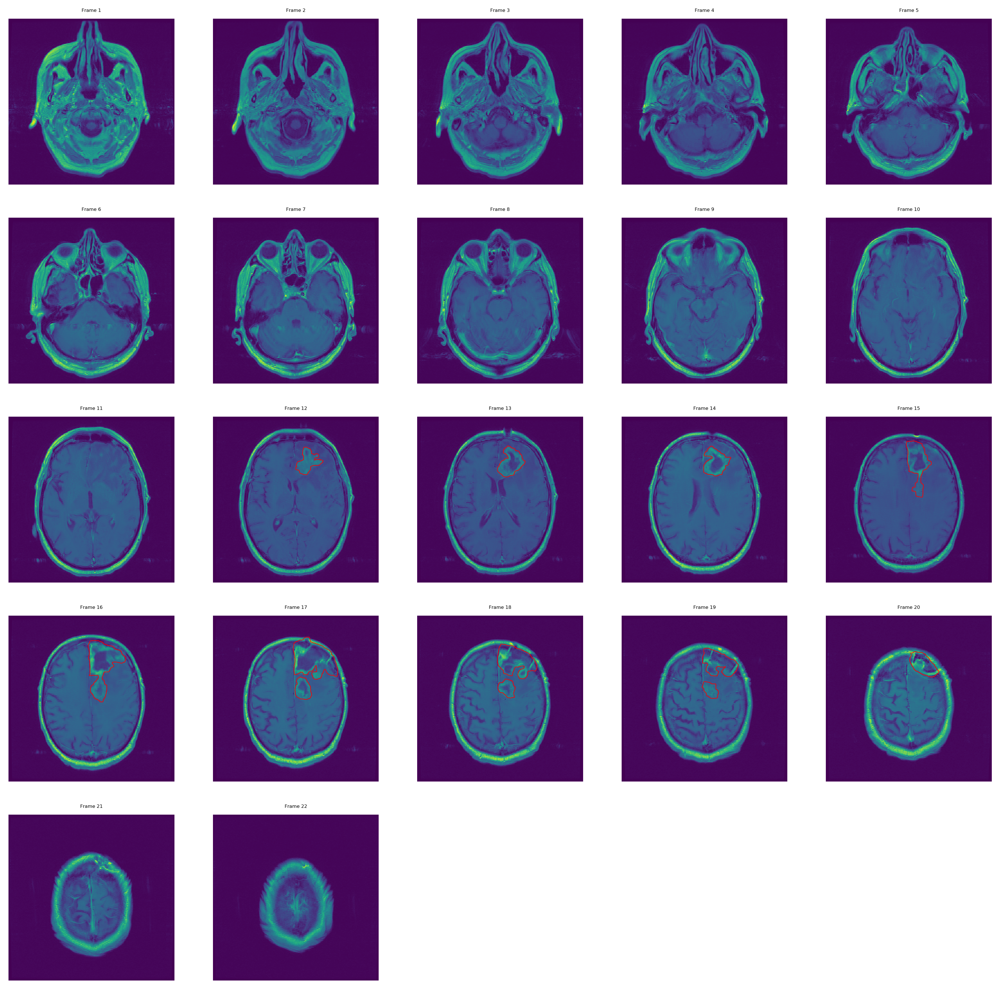

In [312]:
# Define location for plots to be exported to:
exportDir = r'C:\Code\WP1.3_multiple_modalities\trying stuff\plots'

# Decide whether to export plot:
exportPlot = False # no
#exportPlot = True # yes

import PlotDICOMsAndROIs
importlib.reload(PlotDICOMsAndROIs)
from PlotDICOMsAndROIs import PlotDICOMsAndROIs

# First plot the original DICOM series and their corresponding ROIs:
dataDict1 = PlotDICOMsAndROIs(dicomsPath=fromDicomDir, roiPath=fromRoiFpath, exportPlot=exportPlot, exportDir=exportDir)

Study description = MR RCBV SEQUENCE
Patient ID = PGBM-002
Series description = T1post
Plot exported to:

 C:\Code\WP1.3_multiple_modalities\trying stuff\plots\MR RCBV SEQUENCE PGBM-002 T1post.jpg


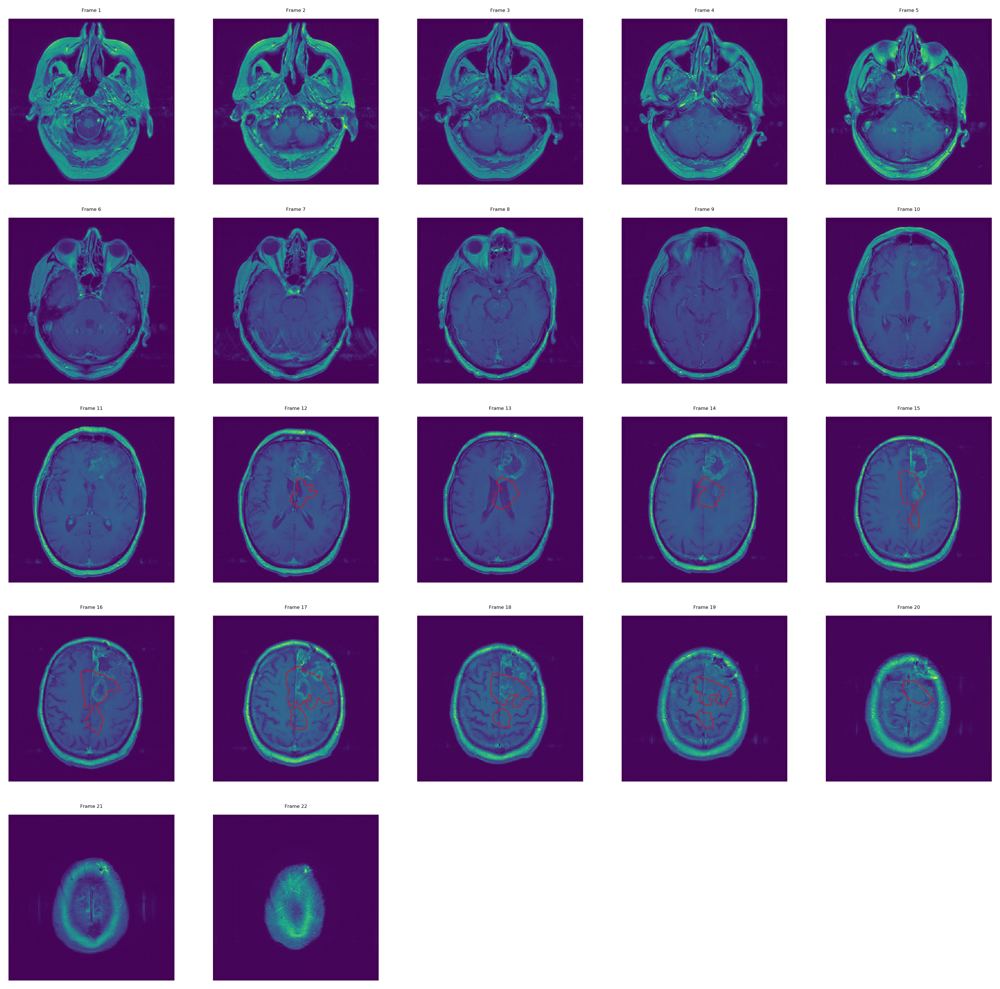

In [313]:
# Plot the new DICOM series with the ROIs from the original DICOM series:
dataDict2 = PlotDICOMsAndROIs(dicomsPath=toDicomDir, roiPath=toRoiFpath, exportPlot=exportPlot, exportDir=exportDir)

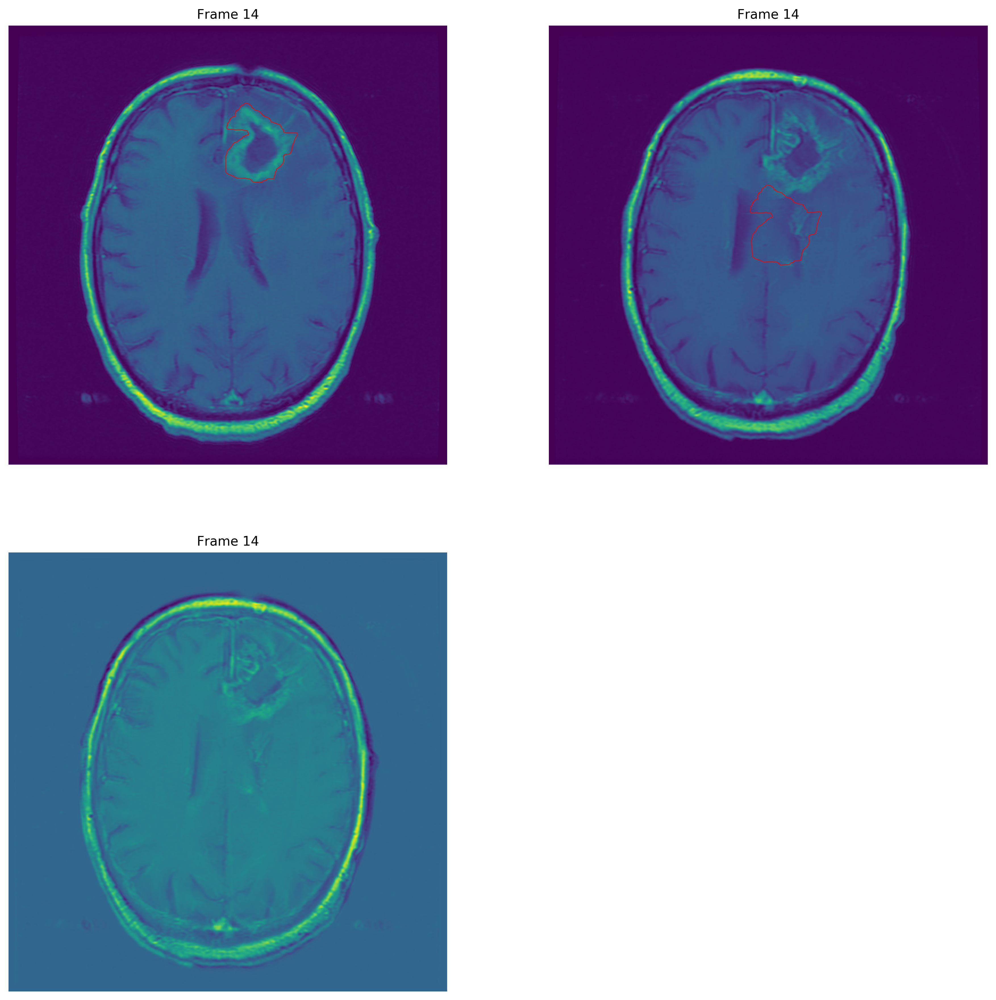

In [296]:
keys1 = list(dataDict1.keys())
keys2 = list(dataDict2.keys())

k = 13

#dataDict1[keys1[k]]

# Set the title font:
fontSize=11

rows = 2
cols = 2

flip = True

plt.figure(figsize=(15,15), dpi=300);
    
i = 0 # for subplot pos

for dictionary in [dataDict1, dataDict2]:
    
    keys = list(dictionary.keys())

    frameNo = dictionary[keys[k]]['Frame number']
    pixArray = dictionary[keys[k]]['Pixel array']
    Ncontours = dictionary[keys[k]]['Number of contours']
    contourPts = dictionary[keys[k]]['Contour points']

    # Plot the pixel array:
    i = i + 1    
    plt.subplot(rows,cols,i, aspect='equal')
    if flip:
        plt.pcolormesh(np.flipud(pixArray));
    else:
        plt.pcolormesh(pixArray);

    plt.title(f'Frame {frameNo}', size=fontSize);
    plt.axis('off');

    # Plot the contours:
    if Ncontours > 0:   
        for c in range(Ncontours):
            # Unpack tuple and store each x,y tuple in arrays X and Y:
            X = []
            Y = []
            for x, y in contourPts[c]:
                X.append(x)
                Y.append(y)

    # Flip Y pixel coordinates if flip=True:
    if flip:
        N_r, N_c = np.shape(pixArray)

        Y = N_c - np.array(Y)

    plt.plot(X, Y, linewidth=0.5, c='red');
    
    
# Plot the difference:
i = i + 1    
plt.subplot(rows,cols,i, aspect='equal')
if flip:
    plt.pcolormesh(np.flipud(dataDict2[keys2[k]]['Pixel array'] - dataDict1[keys1[k]]['Pixel array']));
else:
    plt.pcolormesh(dataDict2[keys2[k]]['Pixel array'] - dataDict1[keys1[k]]['Pixel array']);

plt.title(f'Frame {frameNo}', size=fontSize);
plt.axis('off');

exportFname = r'2020-03-03 Contour from ROI of ' + fromDicomExpLab + ' to ' \
+ toDicomExpLab + f' same frame number {frameNo}.jpg'

exportFpath = os.path.join(exportDir, exportFname)

# Export the plot:
#plt.savefig(exportFpath, bbox_inches='tight')

In [161]:
print('dicom1.FrameOfReferenceUID =', dicom1.FrameOfReferenceUID)
print('dicom1.InStackPositionNumber =', dicom1.InStackPositionNumber)
print('dicom1.ImagesInAcquisition =', dicom1.ImagesInAcquisition)
print('dicom1.ImagePositionPatient =', dicom1.ImagePositionPatient)
print('dicom1.ImageOrientationPatient =', dicom1.ImageOrientationPatient)
print('dicom1.SliceLocation =', dicom1.SliceLocation)
print('')
print('dicom2.FrameOfReferenceUID =', dicom2.FrameOfReferenceUID)
print('dicom2.InStackPositionNumber =', dicom2.InStackPositionNumber)
print('dicom2.ImagesInAcquisition =', dicom2.ImagesInAcquisition)
print('dicom2.ImagePositionPatient =', dicom2.ImagePositionPatient)
print('dicom2.ImageOrientationPatient =', dicom2.ImageOrientationPatient)
print('dicom2.SliceLocation =', dicom2.SliceLocation)

dicom1.FrameOfReferenceUID = 1.3.6.1.4.1.14519.5.2.1.4429.7055.250487807866145927413117906224
dicom1.InStackPositionNumber = 1
dicom1.ImagesInAcquisition = 22
dicom1.ImagePositionPatient = ['-115.545', '-132.514', '-54.8027']
dicom1.ImageOrientationPatient = ['0.997673', '-0.03833', '0.056381', '0.0475315', '0.98392', '-0.172172']
dicom1.SliceLocation = -67.5147934

dicom2.FrameOfReferenceUID = 1.3.6.1.4.1.14519.5.2.1.4429.7055.306844427566369915784964303427
dicom2.InStackPositionNumber = 1
dicom2.ImagesInAcquisition = 22
dicom2.ImagePositionPatient = ['-106.109', '-186.371', '-42.7965']
dicom2.ImageOrientationPatient = ['0.999679', '0.02533', '0', '-0.0244148', '0.963561', '-0.26637']
dicom2.SliceLocation = -72.0400238


# The function PlotDICOMsAndROIs has its uses but I think it would be more convenient to write a similar function that operates on a single DICOM only. 

# That could then be put in a loop to work on any number of DICOMs.

# But first I'll see if I can account for the different Image Positions and Orientations...

In [304]:
# Work with the 13th DICOM file in the first series:
f1 = 13

print(f'Working with the {f1}th (counting from 0) slice in the first DICOM series..\n')

d1_fpath = fpaths1[f1]

d1 = pydicom.read_file(d1_fpath)

#d1_sliceNo = np.array(d1.InStackPositionNumber).astype(np.int)
d1_sliceNo = int(d1.InStackPositionNumber)
d1_sopUid = d1.SOPInstanceUID
#d1_imPosition = np.array(d1.ImagePositionPatient).astype(np.float)
d1_imPosition = [float(item) for item in d1.ImagePositionPatient]
#d1_imOrientation = np.array(d1.ImageOrientationPatient).astype(np.float)
d1_imOrientation = [float(item) for item in d1.ImageOrientationPatient]
#d1_sliceLocation = np.array(d1.SliceLocation).astype(np.float)
d1_sliceLocation = float(d1.SliceLocation)
#d1_Dpix = np.array(d1.PixelSpacing).astype(np.float)
d1_pixSpacing = [float(item) for item in d1.PixelSpacing]
d1_pixArray = d1.pixel_array

#print('d1_sliceLocation =', d1_sliceLocation, '\n')

# Find the slice in the second DICOM series that is closest in location to
# that of the chosen slice in the first DICOM series:

#d2_imPositions = []
#d2_imOrientations = []
d2_sliceLocations = []

# Cycle for each DICOM in the second series:
for f2 in range(len(fpaths2)):
    d2_fpath = fpaths2[f2]

    d2 = pydicom.read_file(d2_fpath)
    
    ##d2_imPosition = np.array(d2.ImagePositionPatient).astype(np.float)
    #d2_imPosition = [float(item) for item in d2.ImagePositionPatient]
    ##d2_imOrientation = np.array(d2.ImageOrientationPatient).astype(np.float)
    #d2_imOrientation = [float(item) for item in d2.ImageOrientationPatient]
    #d2_sliceLocation = np.array(d2.SliceLocation).astype(np.float)
    d2_sliceLocation = float(d2.SliceLocation)
    
    #print('d2_sliceLocation =', d2_sliceLocation)
    
    #d2_imPositions.append(d2_imPosition)
    #d2_imOrientations.append(d2_imOrientation)
    d2_sliceLocations.append(d2_sliceLocation)
    

# Get absolute difference between the slice location of the scan in the first DICOM series
# and all slice locations in the second series:
locAbsDiff = [abs(item - d1_sliceLocation) for item in d2_sliceLocations]

print('The absolute difference between the slice locations locAbsDiff =', locAbsDiff, '\n')
#print('locAbsDiff =', locAbsDiff, '\n')

ind = locAbsDiff.index(min(locAbsDiff))

print('The nearest matching slice ind =', ind, '(counting from 0)\n') # = 14

if 0:
    # Maybe the slice locations need to be compared in addition to the Image Position's z-coord..
    #diff_imPosition = [item2 - item1 for item1 in d1_imPosition for item2 in d2_imPosition]
    diff_imPosition = [d2_imPosition[i] - d1_imPosition[i] for i in range(len(d1_imPosition))]

    print('d1_imPosition =', d1_imPosition)
    print('d2_imPosition =', d2_imPosition)
    print('')
    print('diff_imPosition =', diff_imPosition)
    print('')

    # Get the abs diffs again, but this time subtracting the z-component of the
    # diff_imPosition from d2_sliceLocation:
    locAbsDiff = [abs((item - diff_imPosition[2]) - d1_sliceLocation) for item in d2_sliceLocations] # = 17
    locAbsDiff = [abs((item + diff_imPosition[2]) - d1_sliceLocation) for item in d2_sliceLocations] # = 8

    print('The absolute difference between the slice locations locAbsDiff =', locAbsDiff, '\n')
    #print('locAbsDiff =', locAbsDiff, '\n')

    ind = locAbsDiff.index(min(locAbsDiff))

    print('The nearest matching slice ind =', ind, '\n')

# The above results (slice #17 or #8 depending on whether I subtract or add diff_imPosition 
# from d2_sliceLocation) seem to be worse than not accounting for the difference in slice 
# location (which was #14).  It was slice #13 from the original series (python counting from 0).
# So ignoring the above correction.



#ind = 13 # temp


# Load the DICOM in the second series whose slice location is closest to that of the chosen
# DICOM in the first series:
d2 = pydicom.read_file(fpaths2[ind])

d2_sliceNo = int(d2.InStackPositionNumber)
d2_imPosition = [float(item) for item in d2.ImagePositionPatient]
d2_imOrientation = [float(item) for item in d2.ImageOrientationPatient]
d2_sliceLocation = float(d2.SliceLocation)
d2_pixSpacing = [float(item) for item in d2.PixelSpacing]
d2_pixArray = d2.pixel_array
    
print('d1_sliceNo =', d1_sliceNo, '(counting from 1)')
print('d2_sliceNo =', d2_sliceNo, '(counting from 1)')
print('')
print('d1_sliceLocation =', d1_sliceLocation)
print('d2_sliceLocation =', d2_sliceLocation)
print('')
print('d1_imPosition =', d1_imPosition)
print('d2_imPosition =', d2_imPosition)
print('')
print('d1_imOrientation =', d1_imOrientation)
print('d2_imOrientation =', d2_imOrientation)
print('')

# Get the contour(s) for the chosen slice in the first series. 
print('d1_sopUid =', d1_sopUid)

# Store all ROI Reference SOP Instance UIDs:
r1_sopUids = []

# For any ROI sequence(s) whose Ref SOP UID matches the chosen DICOM SOP UID, store: 
r1_Ncontours = 0
r1_contourNo = [] 
r1_NcontourPts = []
r1_contourData = []

# Loop for each contour sequence:
for sequence in roi1.ROIContourSequence[0].ContourSequence:
    r1_sopUid = sequence.ContourImageSequence[0].ReferencedSOPInstanceUID
    r1_sopUids.append(r1_sopUid)
    #print('r1_sopUid =', r1_sopUid)

    # If this Reference SOP UID (from the ROI) matches the DICOM SOP UID:
    if r1_sopUid == d1_sopUid:
        print('r1_sopUid =', r1_sopUid, '\n')
        # Append the values for this sequence:
        r1_Ncontours = r1_Ncontours + 1 # increment
        r1_contourNo.append(int(sequence.ContourNumber))
        r1_NcontourPts.append(int(sequence.NumberOfContourPoints))
        r1_contourData.append([float(item) for item in sequence.ContourData])


# If there is only one contour:
if 0: # executing the if statement below leads to an error when trying to execute:
    # for p in range(0, len(r1_contourData[c]), 3): further below
    if r1_Ncontours==1:
        r1_contourNo = r1_contourNo[0]
        r1_NcontourPts = r1_NcontourPts[0]
        r1_contourData = r1_contourData[0]

print('r1_Ncontours =', r1_Ncontours)
print('r1_contourNo =', r1_contourNo)
print('r1_NcontourPts =', r1_NcontourPts)

# Convert from patient coords to image coords for the first DICOM:
# (adapted from James Petts' (ICR) Java code)
# The patient coordinates:
x0 = d1_imPosition[0]
y0 = d1_imPosition[1]
z0 = d1_imPosition[2]

# The direction cosines along rows and columns:
#row_x, row_y, row_z, col_x, col_y, col_z = orientation
dir_r = d1_imOrientation[0:3]
dir_c = d1_imOrientation[3:6]

# The indeces of the largest direction cosines along rows and columns:
#ind_r = np.where(theta_r==max(theta_r))[0][0]
#ind_c = np.where(theta_c==max(theta_c))[0][0]
ind_r = dir_r.index(max(dir_r))
ind_c = dir_c.index(max(dir_c))

# The pixel spacings:
dx = d1_pixSpacing[0]
dy = d1_pixSpacing[1]

# Create an array of (x,y) points from the flattened contour data:
r1_contourPts = []

# Iterate for each contour:
for c in range(r1_Ncontours):
    # Store the contour points for each contour:
    r1_contourPts_c = []

    # Iterate for all countour points in threes:
    for p in range(0, len(r1_contourData[c]), 3):
        # Define vector v as the the patient position subtracted from 
        # the contour coordinates:
        v = r1_contourData[c][p] - x0, \
        r1_contourData[c][p+1] - y0, \
        r1_contourData[c][p+2] - z0

        # Convert from patient coord system to image coord system:          
        i = (v[ind_r] - dir_c[ind_r]*v[ind_c]/dir_c[ind_c]) / \
        (dir_r[ind_r]*dx * (1 - (dir_c[ind_r]*dir_r[ind_c])/(dir_r[ind_r]*dir_c[ind_c])))

        j = (v[ind_c] - dir_r[ind_c]*i*dx) / (dir_c[ind_c]*dy)

        r1_contourPts_c.append([i,j])

    # Append contourPts with contourPts_c:
    r1_contourPts.append(r1_contourPts_c)
    
    
    
# Using the contourData for the first DICOM, repeat the conversion from patient 
# coords to image coords for the second DICOM:
# (adapted from James Petts' (ICR) Java code)
# The patient coordinates:
x0 = d2_imPosition[0]
y0 = d2_imPosition[1]
z0 = d2_imPosition[2]

# The direction cosines along rows and columns:
#row_x, row_y, row_z, col_x, col_y, col_z = orientation
dir_r = d2_imOrientation[0:3]
dir_c = d2_imOrientation[3:6]

# The indeces of the largest direction cosines along rows and columns:
ind_r = dir_r.index(max(dir_r))
ind_c = dir_c.index(max(dir_c))

# The pixel spacings:
dx = d2_pixSpacing[0]
dy = d2_pixSpacing[1]

# Create an array of (x,y) points from the flattened contour data:
r2_contourPts = []

# Iterate for each contour:
for c in range(r1_Ncontours):
    # Store the contour points for each contour:
    r2_contourPts_c = []

    # Iterate for all countour points in threes:
    for p in range(0, len(r1_contourData[c]), 3):
        # Define vector v as the the patient position subtracted from 
        # the contour coordinates:
        v = r1_contourData[c][p] - x0, \
        r1_contourData[c][p+1] - y0, \
        r1_contourData[c][p+2] - z0

        # Convert from patient coord system to image coord system:          
        i = (v[ind_r] - dir_c[ind_r]*v[ind_c]/dir_c[ind_c]) / \
        (dir_r[ind_r]*dx * (1 - (dir_c[ind_r]*dir_r[ind_c])/(dir_r[ind_r]*dir_c[ind_c])))

        j = (v[ind_c] - dir_r[ind_c]*i*dx) / (dir_c[ind_c]*dy)

        r2_contourPts_c.append([i,j])

    # Append contourPts with contourPts_c:
    r2_contourPts.append(r2_contourPts_c)

Working with the 13th (counting from 0) slice in the first DICOM series..

The absolute difference between the slice locations locAbsDiff = [87.62692165, 81.36176205, 75.09660244, 68.83144283, 62.566283229999996, 56.30112362, 50.03596401, 43.7708025, 37.505640979999995, 31.24047947, 24.975317955, 18.710156441, 12.444994926, 6.179833411999999, 0.0853280999999999, 6.350489620000001, 12.61565113, 18.88081074, 25.145970339999998, 31.411129950000003, 37.67628956, 43.94144917] 

The nearest matching slice ind = 14 (counting from 0)

d1_sliceNo = 14 (counting from 1)
d2_sliceNo = 15 (counting from 1)

d1_sliceLocation = 15.58689785
d2_sliceLocation = 15.67222595

d1_imPosition = [-119.675, -117.773, 28.299]
d2_imPosition = [-106.723, -162.139, 44.9157]

d1_imOrientation = [0.997673, -0.03833, 0.056381, 0.0475315, 0.98392, -0.172172]
d2_imOrientation = [0.999679, 0.02533, 0.0, -0.0244148, 0.963561, -0.26637]

d1_sopUid = 1.3.6.1.4.1.14519.5.2.1.4429.7055.149742284257271356119234155647
r1_sopUi

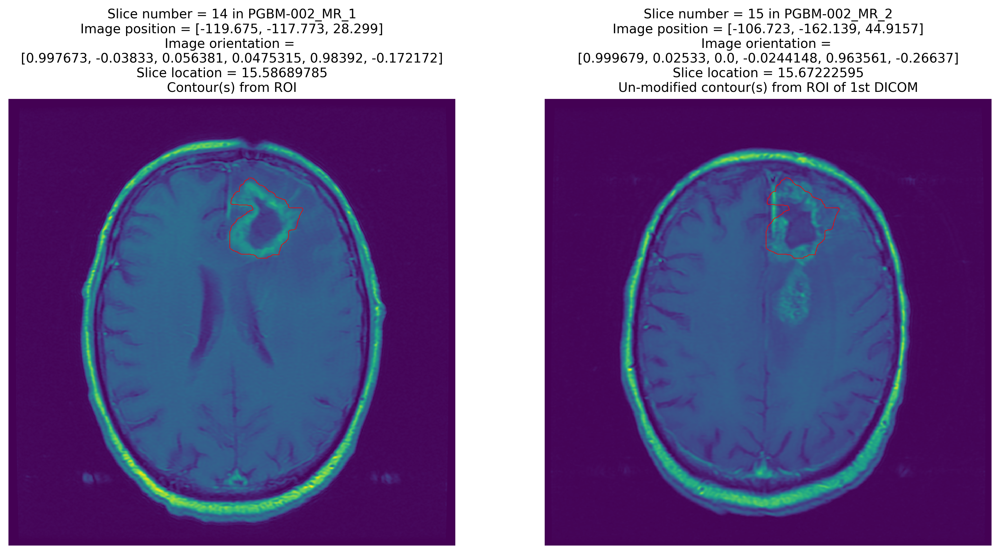

In [305]:
# Plot the results so far:
# Configure plot:

# Set the title font:
fontSize=11

# Set the number of subplot rows and columns:
rows = 2
cols = 2

# Decide whether to flip the images up-down so that the orientation is
# the same as shown in the OHIF-Viewer:
#flip = False
flip = True

# Plot results:

plt.figure(figsize=(15,17), dpi=300);

i = 0 # for subplot pos
  
# SUBPLOT 1: Plot the pixel array for the first DICOM:
i = i + 1    
plt.subplot(rows,cols,i, aspect='equal')
if flip:
    plt.pcolormesh(np.flipud(d1_pixArray));
else:
    plt.pcolormesh(d1_pixArray);

plt.title(f'Slice number = {d1_sliceNo} in ' + fromDicomExpLab \
          + f'\nImage position = {d1_imPosition}' \
          + f'\nImage orientation = \n{d1_imOrientation}' \
          + f'\nSlice location = {d1_sliceLocation}' \
          + '\nContour(s) from ROI', size=fontSize);
plt.axis('off');

# Plot the contour(s):
if r1_Ncontours > 0:   
    for c in range(r1_Ncontours):
        # Unpack tuple and store each x,y tuple in arrays X and Y:
        X = []
        Y = []
        for x, y in r1_contourPts[c]:
            X.append(x)
            Y.append(y)

        # Flip Y pixel coordinates if flip=True:
        if flip:
            N_r, N_c = np.shape(d1_pixArray)

            Y = N_c - np.array(Y)

        plt.plot(X, Y, linewidth=0.5, c='red');
        
# SUBPLOT 2: Plot the pixel array for the second DICOM:
i = i + 1    
plt.subplot(rows,cols,i, aspect='equal')
if flip:
    plt.pcolormesh(np.flipud(d2_pixArray));
else:
    plt.pcolormesh(d2_pixArray);

plt.title(f'Slice number = {d2_sliceNo} in ' + toDicomExpLab \
          + f'\nImage position = {d2_imPosition}' \
          + f'\nImage orientation = \n{d2_imOrientation}' \
          + f'\nSlice location = {d2_sliceLocation}' \
          + '\nUn-modified contour(s) from ROI of 1st DICOM', size=fontSize);
plt.axis('off');

# Plot the contour(s) from the 1st DICOM un-modified:
if r1_Ncontours > 0:   
    for c in range(r1_Ncontours):
        # Unpack tuple and store each x,y tuple in arrays X and Y:
        X = []
        Y = []
        for x, y in r1_contourPts[c]:
            X.append(x)
            Y.append(y)

        # Flip Y pixel coordinates if flip=True:
        if flip:
            N_r, N_c = np.shape(d2_pixArray)

            Y = N_c - np.array(Y)

        plt.plot(X, Y, linewidth=0.5, c='red');


if 0:
    # SUBPLOT 3: Plot the pixel array for the first DICOM (again):
    i = i + 1    
    plt.subplot(rows,cols,i, aspect='equal')
    if flip:
        plt.pcolormesh(np.flipud(d1_pixArray));
    else:
        plt.pcolormesh(d1_pixArray);

    plt.title(f'Slice number = {d1_sliceNo} in ' + fromDicomExpLab \
              + f'\nImage position = {d1_imPosition}' \
              + f'\nImage orientation = \n{d1_imOrientation}' \
              + f'\nSlice location = {d1_sliceLocation}' \
              + '\nContour(s) from ROI \n', size=fontSize);
    plt.axis('off');

    # Plot the contour(s):
    if r1_Ncontours > 0:   
        for c in range(r1_Ncontours):
            # Unpack tuple and store each x,y tuple in arrays X and Y:
            X = []
            Y = []
            for x, y in r1_contourPts[c]:
                X.append(x)
                Y.append(y)

            # Flip Y pixel coordinates if flip=True:
            if flip:
                N_r, N_c = np.shape(d1_pixArray)

                Y = N_c - np.array(Y)

            plt.plot(X, Y, linewidth=0.5, c='red');

    # SUBPLOT 4: Plot the pixel array for the second DICOM (again):
    i = i + 1    
    plt.subplot(rows,cols,i, aspect='equal')
    if flip:
        plt.pcolormesh(np.flipud(d2_pixArray));
    else:
        plt.pcolormesh(d2_pixArray);

    plt.title(f'Slice number = {d2_sliceNo} in ' + toDicomExpLab \
              + f'\nImage position = {d2_imPosition}' \
              + f'\nImage orientation = \n{d2_imOrientation}' \
              + f'\nSlice location = {d2_sliceLocation}' \
              + '\nContour(s) from ROI of 1st DICOM modified using' \
              + '\nImage Position and Orientation of 2nd DICOM', size=fontSize);
    plt.axis('off');

    # Plot the contour(s):
    if r1_Ncontours > 0:   
        for c in range(r1_Ncontours):
            # Unpack tuple and store each x,y tuple in arrays X and Y:
            X = []
            Y = []
            for x, y in r2_contourPts[c]:
                X.append(x)
                Y.append(y)

            # Flip Y pixel coordinates if flip=True:
            if flip:
                N_r, N_c = np.shape(d2_pixArray)

                Y = N_c - np.array(Y)

            plt.plot(X, Y, linewidth=0.5, c='red');


exportFname = r'2020-03-03 Contour from ROI of ' + fromDicomExpLab + ' to ' \
+ toDicomExpLab + ' using Slice Loc.jpg'

exportFpath = os.path.join(exportDir, exportFname)

# Export the plot:
#plt.savefig(exportFpath, bbox_inches='tight')

In [205]:
roi1

(0008, 0016) SOP Class UID                       UI: RT Structure Set Storage
(0008, 0018) SOP Instance UID                    UI: 1.2.826.0.1.534147.578.4208788039.20200231457312
(0008, 0020) Study Date                          DA: '19960813'
(0008, 0030) Study Time                          TM: '162908'
(0008, 0050) Accession Number                    SH: ''
(0008, 0060) Modality                            CS: 'RTSTRUCT'
(0008, 0070) Manufacturer                        LO: 'GE MEDICAL SYSTEMS'
(0008, 0090) Referring Physician's Name          PN: ''
(0008, 1070) Operators' Name                     PN: ''
(0008, 1090) Manufacturer's Model Name           LO: 'Optima MR450w'
(0010, 0010) Patient's Name                      PN: 'PGM-002'
(0010, 0020) Patient ID                          LO: 'PGM-002_MR_1'
(0010, 0030) Patient's Birth Date                DA: '00021130'
(0010, 0040) Patient's Sex                       CS: 'M'
(0018, 1020) Software Version(s)                 LO: ['25', 'LX', '

In [255]:
d1.PatientLocationCoordinatesCodeSequence

AttributeError: 'FileDataset' object has no attribute 'PatientLocationCoordinatesCodeSequence'

# Looks like Slice Location values are not a reliable way of making sense of things:

# https://stackoverflow.com/questions/40138092/dicom-relating-slice-location-to-image-orientation-and-patient-position

# Instead of using the Slice Location, use the Z position as an indicator of slice location:

In [306]:
# Work with the 13th DICOM file in the first series:
f1 = 13

print(f'Working with the {f1}th (counting from 0) slice in the first DICOM series..\n')

d1_fpath = fpaths1[f1]

d1 = pydicom.read_file(d1_fpath)

#d1_sliceNo = np.array(d1.InStackPositionNumber).astype(np.int)
d1_sliceNo = int(d1.InStackPositionNumber)
d1_sopUid = d1.SOPInstanceUID
#d1_imPosition = np.array(d1.ImagePositionPatient).astype(np.float)
d1_imPosition = [float(item) for item in d1.ImagePositionPatient]
#d1_imOrientation = np.array(d1.ImageOrientationPatient).astype(np.float)
d1_imOrientation = [float(item) for item in d1.ImageOrientationPatient]
#d1_sliceLocation = np.array(d1.SliceLocation).astype(np.float)
d1_sliceLocation = float(d1.SliceLocation)
#d1_Dpix = np.array(d1.PixelSpacing).astype(np.float)
d1_pixSpacing = [float(item) for item in d1.PixelSpacing]
d1_pixArray = d1.pixel_array


#print('d1_sliceLocation =', d1_sliceLocation, '\n')

# Find the slice in the second DICOM series that is closest in location to
# that of the chosen slice in the first DICOM series:

d2_imPositions = []
#d2_imOrientations = []
#d2_sliceLocations = []

# Cycle for each DICOM in the second series:
for f2 in range(len(fpaths2)):
    d2_fpath = fpaths2[f2]

    d2 = pydicom.read_file(d2_fpath)
    
    ##d2_imPosition = np.array(d2.ImagePositionPatient).astype(np.float)
    d2_imPosition = [float(item) for item in d2.ImagePositionPatient]
    ##d2_imOrientation = np.array(d2.ImageOrientationPatient).astype(np.float)
    #d2_imOrientation = [float(item) for item in d2.ImageOrientationPatient]
    #d2_sliceLocation = np.array(d2.SliceLocation).astype(np.float)
    #d2_sliceLocation = float(d2.SliceLocation)
    
    #print('d2_sliceLocation =', d2_sliceLocation)
    
    d2_imPositions.append(d2_imPosition)
    #d2_imOrientations.append(d2_imOrientation)
    #d2_sliceLocations.append(d2_sliceLocation)
    

# Get absolute difference between the z-position of the scan in the first DICOM series
# and all z-positions in the second series:
ZposAbsDiff = [abs(item[2] - d1_imPosition[2]) for item in d2_imPositions]

print('The absolute difference between the z-positions ZposAbsDiff =', ZposAbsDiff, '\n')
#print('locAbsDiff =', locAbsDiff, '\n')

ind = ZposAbsDiff.index(min(ZposAbsDiff))

print('The nearest matching slice ind =', ind, '(counting from 0)\n') # = 14

# Maybe the slice locations need to be compared in addition to the Image Position's z-coord..
#diff_imPosition = [item2 - item1 for item1 in d1_imPosition for item2 in d2_imPosition]
diff_imPosition = [d2_imPosition[i] - d1_imPosition[i] for i in range(len(d1_imPosition))]



if 0:
    # Get the abs diffs again, but this time subtracting the z-component of the
    # diff_imPosition from d2_sliceLocation:
    locAbsDiff = [abs((item - diff_imPosition[2]) - d1_sliceLocation) for item in d2_sliceLocations] # = 17
    locAbsDiff = [abs((item + diff_imPosition[2]) - d1_sliceLocation) for item in d2_sliceLocations] # = 8
    
    print('d1_imPosition =', d1_imPosition)
    print('d2_imPosition =', d2_imPosition)
    print('')
    print('diff_imPosition =', diff_imPosition)
    print('')

    print('The absolute difference between the slice locations locAbsDiff =', locAbsDiff, '\n')
    #print('locAbsDiff =', locAbsDiff, '\n')

    ind = locAbsDiff.index(min(locAbsDiff))

    print('The nearest matching slice ind =', ind, '\n')

# The above results (slice #17 or #8 depending on whether I subtract or add diff_imPosition 
# from d2_sliceLocation) seem to be worse than not accounting for the difference in slice 
# location (which was #14).  It was slice #13 from the original series (python counting from 0).
# So ignoring the above correction.



#ind = 13 # temp


# Load the DICOM in the second series whose slice location is closest to that of the chosen
# DICOM in the first series:
d2 = pydicom.read_file(fpaths2[ind])

d2_sliceNo = int(d2.InStackPositionNumber)
d2_imPosition = [float(item) for item in d2.ImagePositionPatient]
d2_imOrientation = [float(item) for item in d2.ImageOrientationPatient]
d2_sliceLocation = float(d2.SliceLocation)
d2_pixSpacing = [float(item) for item in d2.PixelSpacing]
d2_pixArray = d2.pixel_array
    
print('d1_sliceNo =', d1_sliceNo, '(counting from 1)')
print('d2_sliceNo =', d2_sliceNo, '(counting from 1)')
print('')
print('d1_sliceLocation =', d1_sliceLocation)
print('d2_sliceLocation =', d2_sliceLocation)
print('')
print('d1_imPosition =', d1_imPosition)
print('d2_imPosition =', d2_imPosition)
print('')
print('d1_imOrientation =', d1_imOrientation)
print('d2_imOrientation =', d2_imOrientation)
print('')

# Get the contour(s) for the chosen slice in the first series. 
print('d1_sopUid =', d1_sopUid)

# Store all ROI Reference SOP Instance UIDs:
r1_sopUids = []

# For any ROI sequence(s) whose Ref SOP UID matches the chosen DICOM SOP UID, store: 
r1_Ncontours = 0
r1_contourNo = [] 
r1_NcontourPts = []
r1_contourData = []

# Loop for each contour sequence:
for sequence in roi1.ROIContourSequence[0].ContourSequence:
    r1_sopUid = sequence.ContourImageSequence[0].ReferencedSOPInstanceUID
    r1_sopUids.append(r1_sopUid)
    #print('r1_sopUid =', r1_sopUid)

    # If this Reference SOP UID (from the ROI) matches the DICOM SOP UID:
    if r1_sopUid == d1_sopUid:
        print('r1_sopUid =', r1_sopUid, '\n')
        # Append the values for this sequence:
        r1_Ncontours = r1_Ncontours + 1 # increment
        r1_contourNo.append(int(sequence.ContourNumber))
        r1_NcontourPts.append(int(sequence.NumberOfContourPoints))
        r1_contourData.append([float(item) for item in sequence.ContourData])


# If there is only one contour:
if 0: # executing the if statement below leads to an error when trying to execute:
    # for p in range(0, len(r1_contourData[c]), 3): further below
    if r1_Ncontours==1:
        r1_contourNo = r1_contourNo[0]
        r1_NcontourPts = r1_NcontourPts[0]
        r1_contourData = r1_contourData[0]

print('r1_Ncontours =', r1_Ncontours)
print('r1_contourNo =', r1_contourNo)
print('r1_NcontourPts =', r1_NcontourPts)

# Convert from patient coords to image coords for the first DICOM:
# (adapted from James Petts' (ICR) Java code)
# The patient coordinates:
x0 = d1_imPosition[0]
y0 = d1_imPosition[1]
z0 = d1_imPosition[2]

# The direction cosines along rows and columns:
#row_x, row_y, row_z, col_x, col_y, col_z = orientation
dir_r = d1_imOrientation[0:3]
dir_c = d1_imOrientation[3:6]

# The indeces of the largest direction cosines along rows and columns:
#ind_r = np.where(theta_r==max(theta_r))[0][0]
#ind_c = np.where(theta_c==max(theta_c))[0][0]
ind_r = dir_r.index(max(dir_r))
ind_c = dir_c.index(max(dir_c))

# The pixel spacings:
dx = d1_pixSpacing[0]
dy = d1_pixSpacing[1]

# Create an array of (x,y) points from the flattened contour data:
r1_contourPts = []

# Iterate for each contour:
for c in range(r1_Ncontours):
    # Store the contour points for each contour:
    r1_contourPts_c = []

    # Iterate for all countour points in threes:
    for p in range(0, len(r1_contourData[c]), 3):
        # Define vector v as the the patient position subtracted from 
        # the contour coordinates:
        v = r1_contourData[c][p] - x0, \
        r1_contourData[c][p+1] - y0, \
        r1_contourData[c][p+2] - z0

        # Convert from patient coord system to image coord system:          
        i = (v[ind_r] - dir_c[ind_r]*v[ind_c]/dir_c[ind_c]) / \
        (dir_r[ind_r]*dx * (1 - (dir_c[ind_r]*dir_r[ind_c])/(dir_r[ind_r]*dir_c[ind_c])))

        j = (v[ind_c] - dir_r[ind_c]*i*dx) / (dir_c[ind_c]*dy)

        r1_contourPts_c.append([i,j])

    # Append contourPts with contourPts_c:
    r1_contourPts.append(r1_contourPts_c)
    
    
    
# Using the contourData for the first DICOM, repeat the conversion from patient 
# coords to image coords for the second DICOM:
# (adapted from James Petts' (ICR) Java code)
# The patient coordinates:
x0 = d2_imPosition[0]
y0 = d2_imPosition[1]
z0 = d2_imPosition[2]

# The direction cosines along rows and columns:
#row_x, row_y, row_z, col_x, col_y, col_z = orientation
dir_r = d2_imOrientation[0:3]
dir_c = d2_imOrientation[3:6]

# The indeces of the largest direction cosines along rows and columns:
ind_r = dir_r.index(max(dir_r))
ind_c = dir_c.index(max(dir_c))

# The pixel spacings:
dx = d2_pixSpacing[0]
dy = d2_pixSpacing[1]

# Create an array of (x,y) points from the flattened contour data:
r2_contourPts = []

# Iterate for each contour:
for c in range(r1_Ncontours):
    # Store the contour points for each contour:
    r2_contourPts_c = []

    # Iterate for all countour points in threes:
    for p in range(0, len(r1_contourData[c]), 3):
        # Define vector v as the the patient position subtracted from 
        # the contour coordinates:
        v = r1_contourData[c][p] - x0, \
        r1_contourData[c][p+1] - y0, \
        r1_contourData[c][p+2] - z0

        # Convert from patient coord system to image coord system:          
        i = (v[ind_r] - dir_c[ind_r]*v[ind_c]/dir_c[ind_c]) / \
        (dir_r[ind_r]*dx * (1 - (dir_c[ind_r]*dir_r[ind_c])/(dir_r[ind_r]*dir_c[ind_c])))

        j = (v[ind_c] - dir_r[ind_c]*i*dx) / (dir_c[ind_c]*dy)

        r2_contourPts_c.append([i,j])

    # Append contourPts with contourPts_c:
    r2_contourPts.append(r2_contourPts_c)

Working with the 13th (counting from 0) slice in the first DICOM series..

The absolute difference between the z-positions ZposAbsDiff = [71.0955, 64.8303, 58.565200000000004, 52.3, 46.0349, 39.7697, 33.50455, 27.23939, 20.97423, 14.7091, 8.4439, 2.178699999999999, 4.086399999999998, 10.351599999999998, 16.6167, 22.8819, 29.147100000000002, 35.4122, 41.6774, 47.9425, 54.207699999999996, 60.4729] 

The nearest matching slice ind = 11 (counting from 0)

d1_sliceNo = 14 (counting from 1)
d2_sliceNo = 12 (counting from 1)

d1_sliceLocation = 15.58689785
d2_sliceLocation = -3.123258591

d1_imPosition = [-119.675, -117.773, 28.299]
d2_imPosition = [-106.592, -167.332, 26.1203]

d1_imOrientation = [0.997673, -0.03833, 0.056381, 0.0475315, 0.98392, -0.172172]
d2_imOrientation = [0.999679, 0.02533, 0.0, -0.0244148, 0.963561, -0.26637]

d1_sopUid = 1.3.6.1.4.1.14519.5.2.1.4429.7055.149742284257271356119234155647
r1_sopUid = 1.3.6.1.4.1.14519.5.2.1.4429.7055.149742284257271356119234155647 

r1_Nc

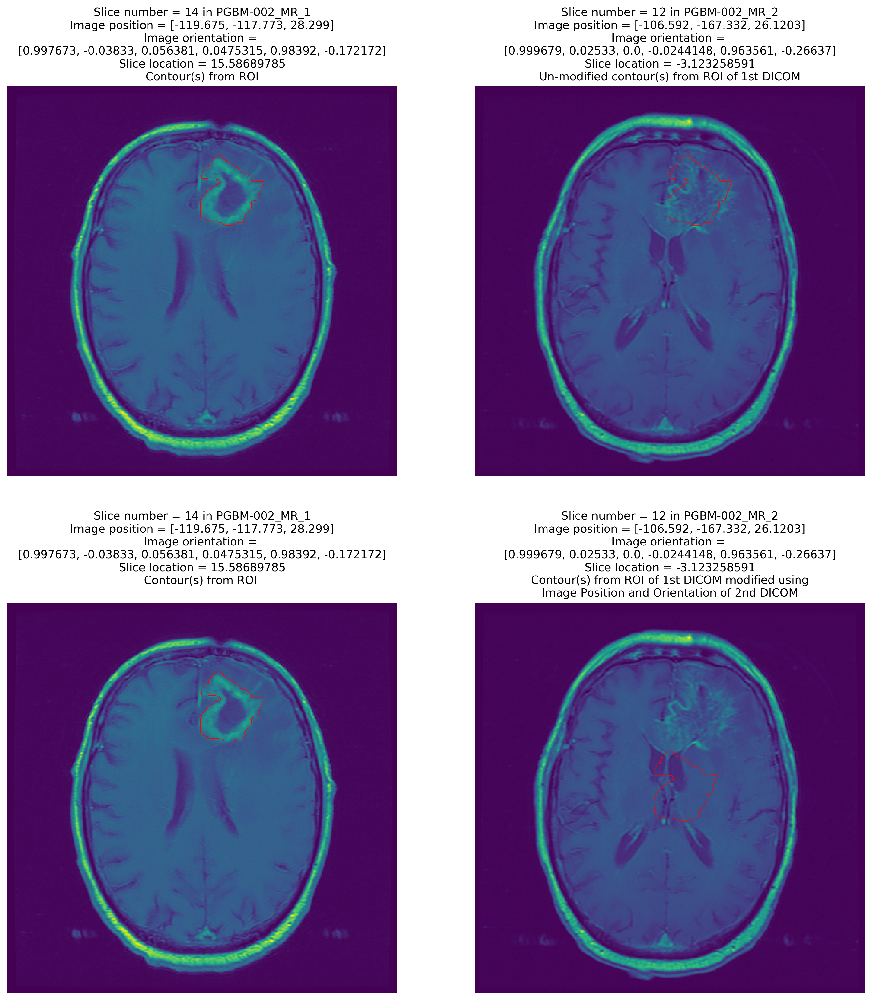

In [307]:
# Plot the results so far:
# Configure plot:

# Set the title font:
fontSize=11

# Set the number of subplot rows and columns:
rows = 2
cols = 2

# Decide whether to flip the images up-down so that the orientation is
# the same as shown in the OHIF-Viewer:
#flip = False
flip = True

# Plot results:

plt.figure(figsize=(15,17), dpi=300);

i = 0 # for subplot pos
  
# SUBPLOT 1: Plot the pixel array for the first DICOM:
i = i + 1    
plt.subplot(rows,cols,i, aspect='equal')
if flip:
    plt.pcolormesh(np.flipud(d1_pixArray));
else:
    plt.pcolormesh(d1_pixArray);

plt.title(f'Slice number = {d1_sliceNo} in ' + fromDicomExpLab \
          + f'\nImage position = {d1_imPosition}' \
          + f'\nImage orientation = \n{d1_imOrientation}' \
          + f'\nSlice location = {d1_sliceLocation}' \
          + '\nContour(s) from ROI', size=fontSize);
plt.axis('off');

# Plot the contour(s):
if r1_Ncontours > 0:   
    for c in range(r1_Ncontours):
        # Unpack tuple and store each x,y tuple in arrays X and Y:
        X = []
        Y = []
        for x, y in r1_contourPts[c]:
            X.append(x)
            Y.append(y)

        # Flip Y pixel coordinates if flip=True:
        if flip:
            N_r, N_c = np.shape(d1_pixArray)

            Y = N_c - np.array(Y)

        plt.plot(X, Y, linewidth=0.5, c='red');
        
# SUBPLOT 2: Plot the pixel array for the second DICOM:
i = i + 1    
plt.subplot(rows,cols,i, aspect='equal')
if flip:
    plt.pcolormesh(np.flipud(d2_pixArray));
else:
    plt.pcolormesh(d2_pixArray);

plt.title(f'Slice number = {d2_sliceNo} in ' + toDicomExpLab \
          + f'\nImage position = {d2_imPosition}' \
          + f'\nImage orientation = \n{d2_imOrientation}' \
          + f'\nSlice location = {d2_sliceLocation}' \
          + '\nUn-modified contour(s) from ROI of 1st DICOM', size=fontSize);
plt.axis('off');

# Plot the contour(s) from the 1st DICOM un-modified:
if r1_Ncontours > 0:   
    for c in range(r1_Ncontours):
        # Unpack tuple and store each x,y tuple in arrays X and Y:
        X = []
        Y = []
        for x, y in r1_contourPts[c]:
            X.append(x)
            Y.append(y)

        # Flip Y pixel coordinates if flip=True:
        if flip:
            N_r, N_c = np.shape(d2_pixArray)

            Y = N_c - np.array(Y)

        plt.plot(X, Y, linewidth=0.5, c='red');


# SUBPLOT 3: Plot the pixel array for the first DICOM (again):
i = i + 1    
plt.subplot(rows,cols,i, aspect='equal')
if flip:
    plt.pcolormesh(np.flipud(d1_pixArray));
else:
    plt.pcolormesh(d1_pixArray);

plt.title(f'Slice number = {d1_sliceNo} in ' + fromDicomExpLab \
          + f'\nImage position = {d1_imPosition}' \
          + f'\nImage orientation = \n{d1_imOrientation}' \
          + f'\nSlice location = {d1_sliceLocation}' \
          + '\nContour(s) from ROI \n', size=fontSize);
plt.axis('off');

# Plot the contour(s):
if r1_Ncontours > 0:   
    for c in range(r1_Ncontours):
        # Unpack tuple and store each x,y tuple in arrays X and Y:
        X = []
        Y = []
        for x, y in r1_contourPts[c]:
            X.append(x)
            Y.append(y)

        # Flip Y pixel coordinates if flip=True:
        if flip:
            N_r, N_c = np.shape(d1_pixArray)

            Y = N_c - np.array(Y)

        plt.plot(X, Y, linewidth=0.5, c='red');
        
# SUBPLOT 4: Plot the pixel array for the second DICOM (again):
i = i + 1    
plt.subplot(rows,cols,i, aspect='equal')
if flip:
    plt.pcolormesh(np.flipud(d2_pixArray));
else:
    plt.pcolormesh(d2_pixArray);

plt.title(f'Slice number = {d2_sliceNo} in ' + toDicomExpLab \
          + f'\nImage position = {d2_imPosition}' \
          + f'\nImage orientation = \n{d2_imOrientation}' \
          + f'\nSlice location = {d2_sliceLocation}' \
          + '\nContour(s) from ROI of 1st DICOM modified using' \
          + '\nImage Position and Orientation of 2nd DICOM', size=fontSize);
plt.axis('off');

# Plot the contour(s):
if r1_Ncontours > 0:   
    for c in range(r1_Ncontours):
        # Unpack tuple and store each x,y tuple in arrays X and Y:
        X = []
        Y = []
        for x, y in r2_contourPts[c]:
            X.append(x)
            Y.append(y)

        # Flip Y pixel coordinates if flip=True:
        if flip:
            N_r, N_c = np.shape(d2_pixArray)

            Y = N_c - np.array(Y)

        plt.plot(X, Y, linewidth=0.5, c='red');



# Maybe it doesn't make sense to subtract the Image Position Patient for the 2nd DICOM from the contour point since the contour point are in absolute coords...

# If so, the relevant results are:

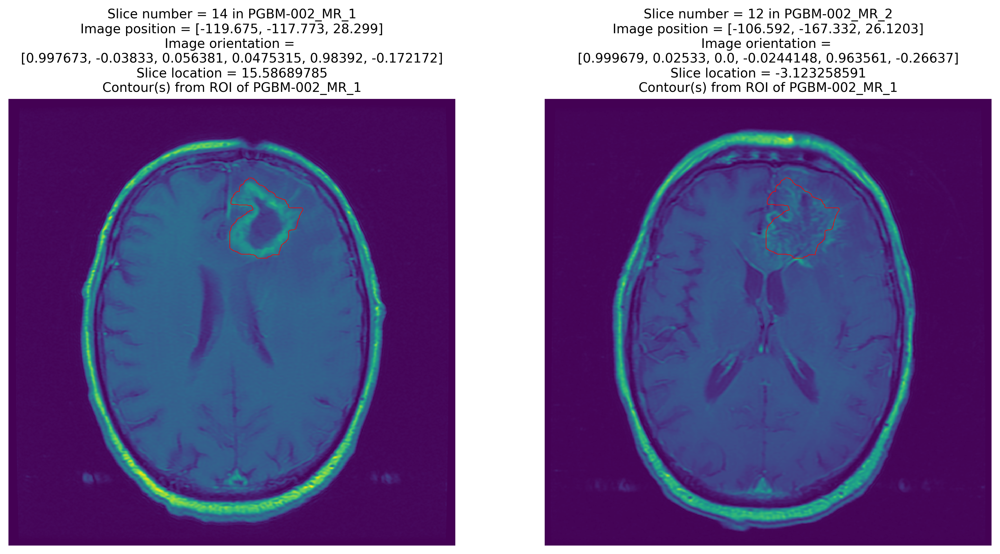

In [308]:
# Plot the results so far:
# Configure plot:

# Set the title font:
fontSize=11

# Set the number of subplot rows and columns:
rows = 1
cols = 2

# Decide whether to flip the images up-down so that the orientation is
# the same as shown in the OHIF-Viewer:
#flip = False
flip = True

# Plot results:

plt.figure(figsize=(15,17), dpi=300);

i = 0 # for subplot pos
  
# SUBPLOT 1: Plot the pixel array for the first DICOM:
i = i + 1    
plt.subplot(rows,cols,i, aspect='equal')
if flip:
    plt.pcolormesh(np.flipud(d1_pixArray));
else:
    plt.pcolormesh(d1_pixArray);

plt.title(f'Slice number = {d1_sliceNo} in ' + fromDicomExpLab \
          + f'\nImage position = {d1_imPosition}' \
          + f'\nImage orientation = \n{d1_imOrientation}' \
          + f'\nSlice location = {d1_sliceLocation}' \
          + '\nContour(s) from ROI of ' + fromDicomExpLab, size=fontSize);
plt.axis('off');

# Plot the contour(s):
if r1_Ncontours > 0:   
    for c in range(r1_Ncontours):
        # Unpack tuple and store each x,y tuple in arrays X and Y:
        X = []
        Y = []
        for x, y in r1_contourPts[c]:
            X.append(x)
            Y.append(y)

        # Flip Y pixel coordinates if flip=True:
        if flip:
            N_r, N_c = np.shape(d1_pixArray)

            Y = N_c - np.array(Y)

        plt.plot(X, Y, linewidth=0.5, c='red');
        
# SUBPLOT 2: Plot the pixel array for the second DICOM:
i = i + 1    
plt.subplot(rows,cols,i, aspect='equal')
if flip:
    plt.pcolormesh(np.flipud(d2_pixArray));
else:
    plt.pcolormesh(d2_pixArray);

plt.title(f'Slice number = {d2_sliceNo} in ' + toDicomExpLab \
          + f'\nImage position = {d2_imPosition}' \
          + f'\nImage orientation = \n{d2_imOrientation}' \
          + f'\nSlice location = {d2_sliceLocation}' \
          + '\nContour(s) from ROI of ' + fromDicomExpLab, size=fontSize);
plt.axis('off');

# Plot the contour(s) from the 1st DICOM un-modified:
if r1_Ncontours > 0:   
    for c in range(r1_Ncontours):
        # Unpack tuple and store each x,y tuple in arrays X and Y:
        X = []
        Y = []
        for x, y in r1_contourPts[c]:
            X.append(x)
            Y.append(y)

        # Flip Y pixel coordinates if flip=True:
        if flip:
            N_r, N_c = np.shape(d2_pixArray)

            Y = N_c - np.array(Y)

        plt.plot(X, Y, linewidth=0.5, c='red');
        

exportFname = r'2020-03-03 Contour from ROI of ' + fromDicomExpLab + ' to ' \
+ toDicomExpLab + ' using z-pos of Image Position to match.jpg'

exportFpath = os.path.join(exportDir, exportFname)

# Export the plot:
#plt.savefig(exportFpath, bbox_inches='tight')

In [293]:
exportFpath

'C:\\Code\\WP1.3_multiple_modalities\\trying stuff\\plots\\2020-03-03 Contour from ROI of PGBM-002_MR_1 to PGBM-002_MR_2.jpg'

In [279]:
# Work out the direction vector of the scanning. I already have worked out d2_imPositions.
# Now get d1_imPositions:

d1_imPositions = []

# Cycle for each DICOM in the first series:
for f in range(len(fpaths1)):
    fpath = fpaths1[f]

    dicom = pydicom.read_file(fpath)
    
    d1_imPosition = [float(item) for item in dicom.ImagePositionPatient]
    
    d1_imPositions.append(d1_imPosition)

In [281]:
d1_imPositions

[[-115.545, -132.514, -54.8027],
 [-115.863, -131.38, -48.4103],
 [-116.181, -130.246, -42.0178],
 [-116.498, -129.112, -35.6254],
 [-116.816, -127.978, -29.2329],
 [-117.134, -126.844, -22.8405],
 [-117.452, -125.71, -16.4481],
 [-117.769, -124.576, -10.0556],
 [-118.087, -123.442, -3.66319],
 [-118.405, -122.308, 2.72925],
 [-118.722, -121.175, 9.12169],
 [-119.04, -120.041, 15.5141],
 [-119.358, -118.907, 21.9066],
 [-119.675, -117.773, 28.299],
 [-119.993, -116.639, 34.6914],
 [-120.311, -115.505, 41.0839],
 [-120.628, -114.371, 47.4763],
 [-120.946, -113.237, 53.8688],
 [-121.264, -112.103, 60.2612],
 [-121.581, -110.969, 66.6536],
 [-121.899, -109.835, 73.0461],
 [-122.217, -108.701, 79.4385]]

In [285]:
d2_imPositions

[[-106.109, -186.371, -42.7965],
 [-106.153, -184.64, -36.5313],
 [-106.197, -182.91, -30.2662],
 [-106.241, -181.179, -24.001],
 [-106.285, -179.448, -17.7359],
 [-106.329, -177.717, -11.4707],
 [-106.372, -175.986, -5.20555],
 [-106.416, -174.255, 1.05961],
 [-106.46, -172.524, 7.32477],
 [-106.504, -170.794, 13.5899],
 [-106.548, -169.063, 19.8551],
 [-106.592, -167.332, 26.1203],
 [-106.636, -165.601, 32.3854],
 [-106.679, -163.87, 38.6506],
 [-106.723, -162.139, 44.9157],
 [-106.767, -160.408, 51.1809],
 [-106.811, -158.678, 57.4461],
 [-106.855, -156.947, 63.7112],
 [-106.899, -155.216, 69.9764],
 [-106.943, -153.485, 76.2415],
 [-106.986, -151.754, 82.5067],
 [-107.03, -150.023, 88.7719]]

In [284]:
# Work out the scan direction for the first series:
#d1_scanDir = []

d1_imPosDiffs = []
d2_imPosDiffs = []

for f in range(len(d1_imPositions) - 1):
    #d1_imPosDiff = d1_imPositions[f+1] - d1_imPositions[f]
    
    d1_imPosDiff = [d1_imPositions[f+1][0] - d1_imPositions[f][0], \
                    d1_imPositions[f+1][1] - d1_imPositions[f][1], \
                    d1_imPositions[f+1][2] - d1_imPositions[f][2]]
    
    d2_imPosDiff = [d2_imPositions[f+1][0] - d2_imPositions[f][0], \
                    d2_imPositions[f+1][1] - d2_imPositions[f][1], \
                    d2_imPositions[f+1][2] - d2_imPositions[f][2]]
    
    d1_imPosDiffs.append(d1_imPosDiff)
    d2_imPosDiffs.append(d2_imPosDiff)

In [286]:
d1_imPosDiffs

[[-0.31799999999999784, 1.1340000000000146, 6.392400000000002],
 [-0.31799999999999784, 1.1339999999999861, 6.392499999999998],
 [-0.3170000000000073, 1.1340000000000146, 6.392400000000002],
 [-0.31799999999999784, 1.1340000000000003, 6.392499999999998],
 [-0.31799999999999784, 1.1340000000000003, 6.392400000000002],
 [-0.31799999999999784, 1.1340000000000003, 6.3923999999999985],
 [-0.3170000000000073, 1.1340000000000003, 6.3925],
 [-0.31799999999999784, 1.1340000000000003, 6.39241],
 [-0.31799999999999784, 1.1339999999999861, 6.392440000000001],
 [-0.31699999999999307, 1.1330000000000098, 6.392439999999999],
 [-0.31800000000001205, 1.1340000000000003, 6.39241],
 [-0.31799999999999784, 1.1340000000000003, 6.392500000000002],
 [-0.31699999999999307, 1.1340000000000003, 6.3923999999999985],
 [-0.31799999999999784, 1.1340000000000003, 6.392400000000002],
 [-0.31800000000001205, 1.1340000000000003, 6.392499999999998],
 [-0.31699999999999307, 1.1340000000000003, 6.392400000000002],
 [-0.31

In [287]:
d2_imPosDiffs

[[-0.04400000000001114, 1.731000000000023, 6.2652],
 [-0.04399999999999693, 1.7299999999999898, 6.2651],
 [-0.04399999999999693, 1.7309999999999945, 6.2652],
 [-0.04399999999999693, 1.7309999999999945, 6.2651],
 [-0.04399999999999693, 1.7309999999999945, 6.2652],
 [-0.043000000000006366, 1.731000000000023, 6.265150000000001],
 [-0.04399999999999693, 1.7309999999999945, 6.26516],
 [-0.04399999999999693, 1.7309999999999945, 6.26516],
 [-0.04400000000001114, 1.7299999999999898, 6.26513],
 [-0.04399999999999693, 1.731000000000023, 6.2652],
 [-0.04399999999999693, 1.7309999999999945, 6.2652],
 [-0.04399999999999693, 1.7309999999999945, 6.265099999999997],
 [-0.043000000000006366, 1.7309999999999945, 6.2652],
 [-0.04399999999999693, 1.7309999999999945, 6.265100000000004],
 [-0.04399999999999693, 1.731000000000023, 6.2652],
 [-0.04400000000001114, 1.7299999999999898, 6.2652],
 [-0.04399999999999693, 1.7309999999999945, 6.265099999999997],
 [-0.04399999999999693, 1.7309999999999945, 6.2652],
 

In [288]:
d1.SliceThickness

"5"

In [289]:
d2.SliceThickness

"5"